In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

data = pd.read_csv('../DataOut/bus_trip_all_points.csv')

In [2]:
# import bus trips
bus_trips = pd.read_csv("../DataOut/bus_trips.csv")

In [3]:
data

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction
0,574733098,116,2021-10-16 08:03:04,7.293092,80.635573,9.17927,2021-10-16,08:03:04,POINT (184746.41595346577 232322.75960448402),BT01,2.0,1
1,574733099,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,POINT (184841.00784031872 232320.15459256113),NaN,2.0,1
2,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1
3,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1
4,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
303224,585350956,1377,2021-10-27 19:02:53,7.290715,80.638227,5.39957,2021-10-27,19:02:53,POINT (185039.30275057122 232059.86188720367),NaN,1365.0,2
303225,585350957,1377,2021-10-27 19:03:08,7.291095,80.637743,8.09935,2021-10-27,19:03:08,POINT (184985.95129993305 232101.89901670374),NaN,1365.0,2
303226,585351802,1377,2021-10-27 19:03:23,7.291273,80.637273,5.39957,2021-10-27,19:03:23,POINT (184934.06182375905 232121.63129080654),NaN,1365.0,2
303227,585351803,1377,2021-10-27 19:03:38,7.291202,80.636218,18.89850,2021-10-27,19:03:38,POINT (184817.57099444696 232113.7373533016),NaN,1365.0,2


In [176]:
# get the number of unique deviceid
deviceid = data['deviceid'].unique()
deviceid

array([ 116,  117,  123,  128,  262,  264,  274,  279,  294,  505,  513,
       1143, 1358, 1377], dtype=int64)

## Detect and remove Anomaly Trips

In [4]:
from sklearn.metrics.pairwise import haversine_distances
from math import radians

# Define a function to calculate Haversine distance between two points
def haversine_distance(coord1, coord2):
    coord1 = [radians(x) for x in coord1]
    coord2 = [radians(x) for x in coord2]
    dist = haversine_distances([coord1, coord2])
    return dist[0][1] * 6371000.0  # Multiply by Earth radius to get distance in meters

# Define the anomaly detection function
def detect_anomalies(data, trip_id_column, longitude_column, latitude_column, reference_data, reference_trip_id, threshold_distance_meters=200):
    reference_locations = reference_data[reference_data[trip_id_column] == reference_trip_id]
    reference_locations = reference_locations[[latitude_column, longitude_column]].values
    
    anomalies = []
    for trip_id in data[trip_id_column].unique():
        trip_data = data[data[trip_id_column] == trip_id]
        gps_locations = trip_data[[latitude_column, longitude_column]].values
        
        anomaly_count = 0
        for location in gps_locations:
            min_distance = min([haversine_distance(location, ref_loc) for ref_loc in reference_locations])
            if min_distance > threshold_distance_meters:
                anomaly_count += 1
        print(f"anomaly count : {anomaly_count}")
        if anomaly_count / len(gps_locations) >= 0.1:
            anomalies.append(trip_id)
            print(f"anomaly trip id : {trip_id}")
    
    return anomalies

# Columns for trip ID, longitude, and latitude in your DataFrame
trip_id_column = 'trip_id'
longitude_column = 'longitude'
latitude_column = 'latitude'

# Reference data for correct GPS locations (longitude and latitude values)
reference_trip_id = 4  # Specify the trip ID for which to get the reference data
reference_data = data[data[trip_id_column] == reference_trip_id]  # Filter reference data

# Detect and remove anomaly trips
anomaly_trip_ids = detect_anomalies(data, trip_id_column, longitude_column, latitude_column, reference_data, reference_trip_id)
cleaned_data = data[~data[trip_id_column].isin(anomaly_trip_ids)]

print(f"Anomaly trips detected and removed: {anomaly_trip_ids}")

# save anomally trip id list in to csv file
anomaly_trip_ids_df = pd.DataFrame(anomaly_trip_ids)
anomaly_trip_ids_df.to_csv('../DataOut/anomaly_trip_ids.csv', index=False)



In [5]:
# # Anomaly trips detected and removed: [166.0, 193.0, 195.0, 207.0, 235.0, 1081.0, 1105.0, 141.0, 147.0, 153.0, 155.0, 157.0, 160.0, 171.0, 177.0, 190.0, 194.0, 206.0, 210.0, 226.0, 879.0]
# anomaly_trip_ids=[166.0, 193.0, 195.0, 207.0, 235.0, 1081.0, 1105.0, 141.0, 147.0, 153.0, 155.0, 157.0, 160.0, 171.0, 177.0, 190.0, 194.0, 206.0, 210.0, 226.0, 879.0]
# cleaned_data = data[~data['trip_id'].isin(anomaly_trip_ids)]

# data= cleaned_data

# print(f"Anomaly trips detected and removed: {anomaly_trip_ids}")

Anomaly trips detected and removed: [166.0, 193.0, 195.0, 207.0, 235.0, 1081.0, 1105.0, 141.0, 147.0, 153.0, 155.0, 157.0, 160.0, 171.0, 177.0, 190.0, 194.0, 206.0, 210.0, 226.0, 879.0]


In [6]:
# len(anomaly_trip_ids)

## feature Eng

### Add Acceleration

In [7]:
import pandas as pd
import numpy as np

# Assuming you have a DataFrame named 'data' with columns: 'speed', 'devicetime', and 'trip_id'
# Convert the 'devicetime' column to pandas Timestamp if it's not already
data['devicetime'] = pd.to_datetime(data['devicetime'])

# Calculate time difference between consecutive rows within the same trip
data['time_diff'] = data.groupby('trip_id')['devicetime'].diff()

# Calculate change in speed between consecutive rows within the same trip
data['speed_diff'] = data.groupby('trip_id')['speed'].diff()

# Filter out rows with time differences close to zero
data = data[data['time_diff'].dt.total_seconds() > 0.001]  # Adjust the threshold as needed

# Calculate acceleration by dividing speed difference by time difference (avoiding division by zero)
data['acceleration'] = data['speed_diff'] / data['time_diff'].dt.total_seconds()

# Handle the case where time difference is zero or very close to zero, set acceleration to 0
data['acceleration'].replace([np.inf, -np.inf], np.nan, inplace=True)
data['acceleration'].fillna(0, inplace=True)

print(data)


C:\Users\gw\AppData\Local\Temp\ipykernel_19624\493667457.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['devicetime'] = pd.to_datetime(data['devicetime'])
C:\Users\gw\AppData\Local\Temp\ipykernel_19624\493667457.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['time_diff'] = data.groupby('trip_id')['devicetime'].diff()
C:\Users\gw\AppData\Local\Temp\ipykernel_19624\493667457.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[ro

               id  deviceid          devicetime  latitude  longitude  \
1       574733099       116 2021-10-16 08:03:19  7.293068  80.636430   
2       574733100       116 2021-10-16 08:03:34  7.293043  80.637552   
3       574733101       116 2021-10-16 08:03:49  7.292725  80.637707   
4       574733102       116 2021-10-16 08:04:04  7.292292  80.637663   
5       574736662       116 2021-10-16 08:04:19  7.291640  80.637455   
...           ...       ...                 ...       ...        ...   
303224  585350956      1377 2021-10-27 19:02:53  7.290715  80.638227   
303225  585350957      1377 2021-10-27 19:03:08  7.291095  80.637743   
303226  585351802      1377 2021-10-27 19:03:23  7.291273  80.637273   
303227  585351803      1377 2021-10-27 19:03:38  7.291202  80.636218   
303228  585351804      1377 2021-10-27 19:03:53  7.291602  80.635130   

           speed        date      time  \
1       14.03890  2021-10-16  08:03:19   
2       10.25920  2021-10-16  08:03:34   
3        

In [8]:
import pandas as pd

# Count Infinity values in each column
infinity_count = data.isin([np.inf, -np.inf]).sum()

print("Number of Infinity values in each column:")
print(infinity_count)


Number of Infinity values in each column:
id              0
deviceid        0
devicetime      0
latitude        0
longitude       0
speed           0
date            0
time            0
geometry        0
bus_stop        0
trip_id         0
direction       0
time_diff       0
speed_diff      0
acceleration    0
dtype: int64


In [9]:
# fill Nan values with 0
data['acceleration'].fillna(0, inplace=True)
# drop time_diff and speed_diff columns
data.drop(['time_diff', 'speed_diff'], axis=1, inplace=True)

C:\Users\gw\AppData\Local\Temp\ipykernel_19624\1802797475.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['acceleration'].fillna(0, inplace=True)
C:\Users\gw\AppData\Local\Temp\ipykernel_19624\1802797475.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop(['time_diff', 'speed_diff'], axis=1, inplace=True)


In [10]:
# save to csv
data.to_csv('../DataOut/bus_trip_all_points_with_acceleration.csv', index=False)

In [11]:
data

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration
1,574733099,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,POINT (184841.00784031872 232320.15459256113),NaN,2.0,1,0.323975
2,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980
3,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987
4,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980
5,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971
...,...,...,...,...,...,...,...,...,...,...,...,...,...
303224,585350956,1377,2021-10-27 19:02:53,7.290715,80.638227,5.39957,2021-10-27,19:02:53,POINT (185039.30275057122 232059.86188720367),NaN,1365.0,2,-0.431969
303225,585350957,1377,2021-10-27 19:03:08,7.291095,80.637743,8.09935,2021-10-27,19:03:08,POINT (184985.95129993305 232101.89901670374),NaN,1365.0,2,0.179985
303226,585351802,1377,2021-10-27 19:03:23,7.291273,80.637273,5.39957,2021-10-27,19:03:23,POINT (184934.06182375905 232121.63129080654),NaN,1365.0,2,-0.179985
303227,585351803,1377,2021-10-27 19:03:38,7.291202,80.636218,18.89850,2021-10-27,19:03:38,POINT (184817.57099444696 232113.7373533016),NaN,1365.0,2,0.899929


### Radial Acc

In [12]:
from math import cos, radians, sqrt
from pyproj import Proj, Transformer

def lat_lon_to_utm(lat, lon):
    # Create a UTM projection for the appropriate UTM zone (Zone 44N for Sri Lanka)
    utm_zone = 44
    utm_proj = Proj(proj='utm', zone=utm_zone, ellps='WGS84')

    # Convert latitude and longitude to UTM coordinates
    utm_easting, utm_northing = utm_proj(lon, lat)
    return utm_easting, utm_northing
# Calculate radius of curvature using OpenStreetMap API

def calculate_radius_of_curvature(x1, y1, x2, y2, x3,y3):
    x12 = x1 - x2;
    x13 = x1 - x3;
 
    y12 = y1 - y2;
    y13 = y1 - y3;
 
    y31 = y3 - y1;
    y21 = y2 - y1;
 
    x31 = x3 - x1;
    x21 = x2 - x1;
 
    # x1^2 - x3^2
    sx13 = pow(x1, 2) - pow(x3, 2);
 
    # y1^2 - y3^2
    sy13 = pow(y1, 2) - pow(y3, 2);
 
    sx21 = pow(x2, 2) - pow(x1, 2);
    sy21 = pow(y2, 2) - pow(y1, 2);
    
    denominator = 2 * ((y31) * (x12) - (y21) * (x13))
    
    # Avoid division by zero
    if denominator == 0:
        return 0  # Or some other value you want to use
        
    f = (((sx13) * (x12) + (sy13) *
          (x12) + (sx21) * (x13) +
          (sy21) * (x13)) // denominator)
             
    g = (((sx13) * (y12) + (sy13) * (y12) +
          (sx21) * (y13) + (sy21) * (y13)) //
          (2 * ((x31) * (y12) - (x21) * (y13))));
 
    c = (-pow(x1, 2) - pow(y1, 2) -
         2 * g * x1 - 2 * f * y1);
 
    # eqn of circle be x^2 + y^2 + 2*g*x + 2*f*y + c = 0
    # where centre is (h = -g, k = -f) and
    # radius r as r^2 = h^2 + k^2 - c
    h = -g;
    k = -f;
    sqr_of_r = h * h + k * k - c;
 
    # r is the radius
    r = round(sqrt(sqr_of_r), 5);
    return r
    

# Calculate radial acceleration based on speed and radius of curvature
def calculate_radial_acceleration(speed, radius_of_curvature):
    if radius_of_curvature != 0:
        radial_acceleration = speed**2 / radius_of_curvature
    else:
        radial_acceleration = 0
    return radial_acceleration

# Create a dictionary to store DataFrames for each trip ID
trip_dataframes = {}
window_size = 1  # Number of rows to use for calculating radius of curvature
trips=data['trip_id'].unique()
# Iterate over trip IDs to calculate radial acceleration for each trip's DataFrame
for trip_id in trips:
    trip_df = data[data["trip_id"] == trip_id].copy()  # Get DataFrame for the current trip
    
    # Reset the index of trip_df only once
    trip_df.reset_index(drop=True, inplace=True)
    
    for i in range(window_size, len(trip_df) - window_size):
        lat1, lon1 = trip_df.iloc[i - window_size]["latitude"], trip_df.iloc[i - window_size]["longitude"]
        lat2, lon2 = trip_df.iloc[i]["latitude"], trip_df.iloc[i]["longitude"]
        lat3, lon3 = trip_df.iloc[i + window_size]["latitude"], trip_df.iloc[i + window_size]["longitude"]
        
        x1, y1 = lat_lon_to_utm(lat1, lon1)
        x2, y2 = lat_lon_to_utm(lat2, lon2)
        x3, y3 = lat_lon_to_utm(lat3, lon3)

        radius_of_curvature = calculate_radius_of_curvature(x1, y1, x2, y2, x3, y3)
        speed = trip_df.iloc[i]["speed"]

        radial_acceleration = calculate_radial_acceleration(speed, radius_of_curvature)
        trip_df.at[i, "radial_acceleration"] = radial_acceleration

    trip_dataframes[trip_id] = trip_df  # Store the calculated DataFrame for the trip

# Concatenate all trip-specific dataframes into one
concatenated_df = pd.concat(trip_dataframes.values(), ignore_index=True)

# Iterate through rows and assign radial acceleration values to the original dataframe
for index, row in concatenated_df.iterrows():
    data.loc[data['id'] == row['id'], 'radial_acceleration'] = row['radial_acceleration']

print(data)

In [13]:
trip_dataframes[30].head(20)

In [14]:
# fill Nan values with 0
data['radial_acceleration'].fillna(0, inplace=True)

In [15]:
data.to_csv('../DataOut/bus_trip_all_points_with_acceleration_and_radial_acceleration.csv', index=False)

In [16]:
# data = pd.read_csv('../DataOut/bus_trip_all_points_with_acceleration_and_radial_acceleration.csv')

In [17]:
data

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration
0,574733099,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,POINT (184841.00784031872 232320.15459256113),NaN,2.0,1,0.323975,0.000000
1,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067
2,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300
3,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332
4,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
289611,585350956,1377,2021-10-27 19:02:53,7.290715,80.638227,5.39957,2021-10-27,19:02:53,POINT (185039.30275057122 232059.86188720367),NaN,1365.0,2,-0.431969,0.096208
289612,585350957,1377,2021-10-27 19:03:08,7.291095,80.637743,8.09935,2021-10-27,19:03:08,POINT (184985.95129993305 232101.89901670374),NaN,1365.0,2,0.179985,0.322474
289613,585351802,1377,2021-10-27 19:03:23,7.291273,80.637273,5.39957,2021-10-27,19:03:23,POINT (184934.06182375905 232121.63129080654),NaN,1365.0,2,-0.179985,0.144867
289614,585351803,1377,2021-10-27 19:03:38,7.291202,80.636218,18.89850,2021-10-27,19:03:38,POINT (184817.57099444696 232113.7373533016),NaN,1365.0,2,0.899929,1.215854


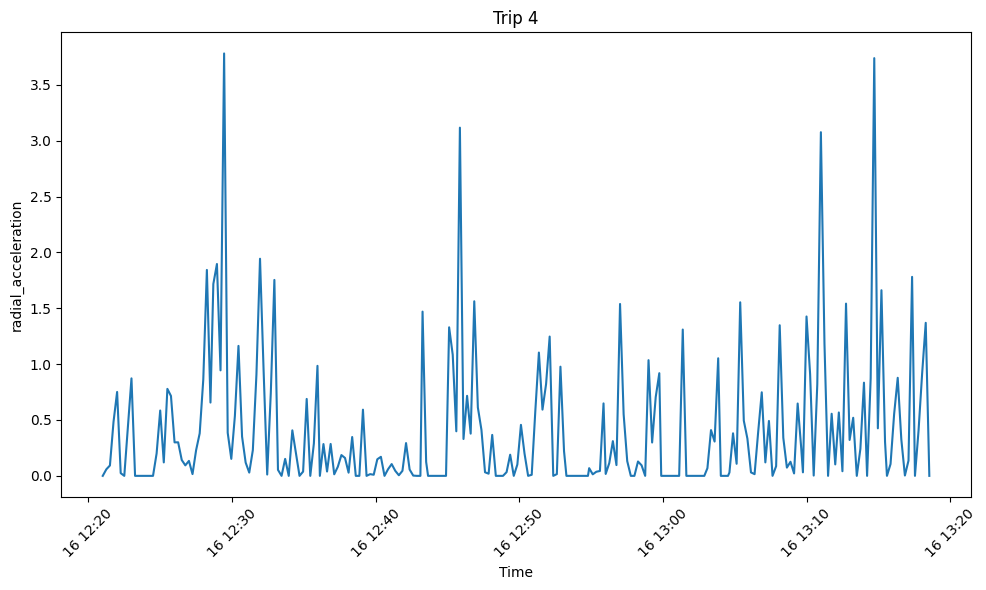

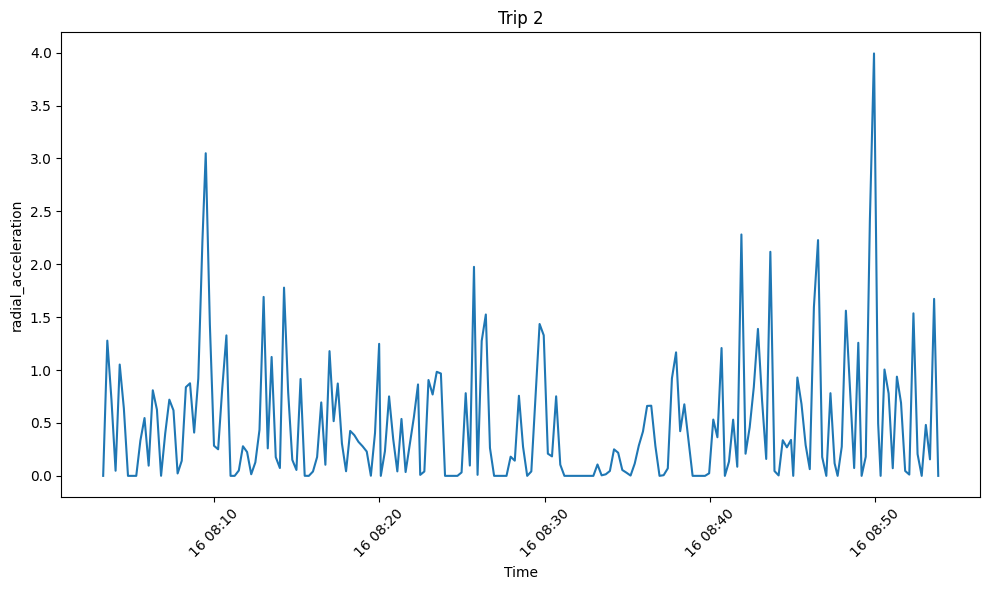

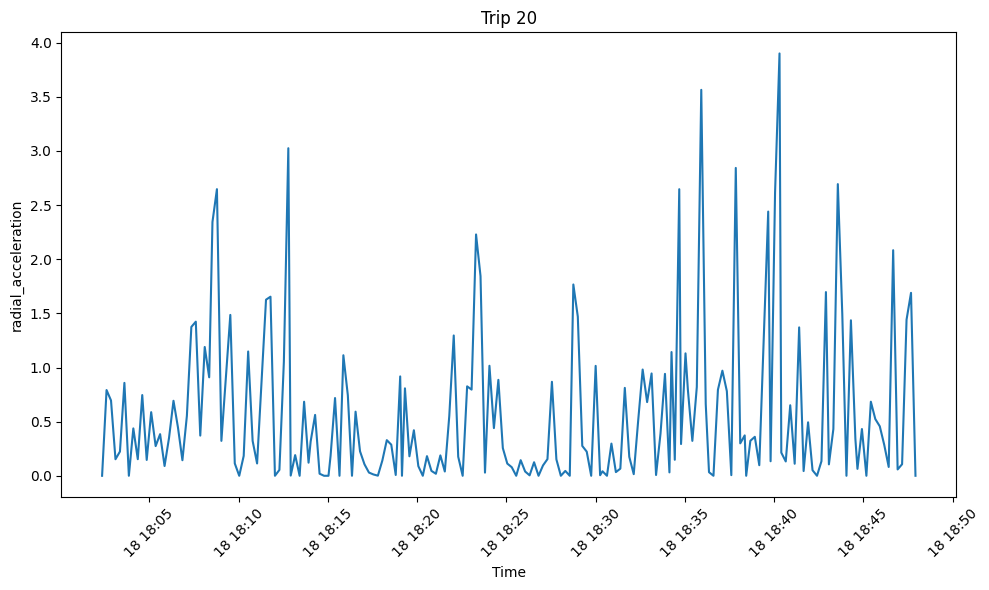

In [18]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming you have 'data' DataFrame containing bus data

# Convert 'devicetime' column to datetime
data['devicetime'] = pd.to_datetime(data['devicetime'])

# Draw a line graph of radial acceleration against time for a single trip
def draw_radial_acceleration_graph(trip_id):
    trip_df = data[data["trip_id"] == trip_id]
    plt.figure(figsize=(10, 6))  # Adjust figure size as needed
    plt.plot(trip_df["devicetime"], trip_df["radial_acceleration"])
    plt.xlabel("Time")
    plt.ylabel("radial_acceleration")
    plt.title("Trip " + str(trip_id))
    plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
    plt.tight_layout()  # Adjust layout for better formatting
    plt.show()

draw_radial_acceleration_graph(4)
draw_radial_acceleration_graph(2)
draw_radial_acceleration_graph(20)


In [19]:
data.head(20)

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration
0,574733099,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,POINT (184841.00784031872 232320.15459256113),NaN,2.0,1,0.323975,0.000000
1,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067
2,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300
3,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332
4,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222
5,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311
6,574736664,116,2021-10-16 08:04:49,7.290943,80.638160,0.00000,2021-10-16,08:04:49,POINT (185031.9565310351 232085.11003064158),101,2.0,1,-0.575954,0.000000
7,574736665,116,2021-10-16 08:05:04,7.290943,80.638157,0.00000,2021-10-16,08:05:04,POINT (185031.58111776915 232085.11014168937),101,2.0,1,0.000000,0.000000
8,574736666,116,2021-10-16 08:05:19,7.290943,80.638157,0.00000,2021-10-16,08:05:19,POINT (185031.58111776915 232085.11014168937),101,2.0,1,0.000000,0.000000
9,574736667,116,2021-10-16 08:05:34,7.290752,80.638305,6.47948,2021-10-16,08:05:34,POINT (185047.9605390529 232063.90664561786),101,2.0,1,0.431965,0.333808


### Distance from start

In [20]:

pip install osmnx


[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


#### Using path points

In [21]:
# # Choose a trip ID from the data DataFrame
# chosen_trip_id = 4

# # Get the longitude and latitude values for the chosen trip ID
# trip_data = data[data['trip_id'] == chosen_trip_id]
# point_path = list(zip(trip_data['latitude'], trip_data['longitude']))

In [22]:
# point_path

In [23]:
# import osmnx as ox
# import folium
# from shapely.geometry import LineString, Point

# # Convert the tuples to Shapely Point objects
# custom_path_points = [Point(lon, lat) for lon, lat in point_path]

# # Create a LineString geometry from the custom path points
# custom_path = LineString(custom_path_points)

# # Calculate the length of the custom path in meters
# custom_path_length = custom_path.length

# # Define the two locations (latitude, longitude)
# latitude1, longitude1 = (7.293085, 80.6356416)  # Example coordinates for location 1
# latitude2, longitude2 = (7.28418, 80.70211)  # Example coordinates for location 2

# # ... (the rest of your code remains the same)

# # Calculate the distance between each consecutive pair of points in the custom path
# custom_path_distances = [custom_path_points[i].distance(custom_path_points[i+1]) for i in range(len(custom_path_points)-1)]

# # Calculate the total distance along the custom path
# total_custom_distance = sum(custom_path_distances)

# print(f"Along-the-road distance along the custom path: {custom_road_distance:.2f} meters")
# print(f"Distance of the custom path itself: {custom_path_length:.2f} meters")

# # Visualize the custom route on a map using folium
# custom_route_nodes = [(G.nodes[node]['y'], G.nodes[node]['x']) for node in shortest_route]
# m = folium.Map(location=(latitude1, longitude1), zoom_start=13)
# folium.PolyLine(locations=custom_route_nodes, color='blue').add_to(m)
# folium.Marker(location=(latitude1, longitude1), popup='Start').add_to(m)
# folium.Marker(location=(latitude2, longitude2), popup='End').add_to(m)

# # Display the map
# m.save('custom_route.html')  # Save the map as an HTML file
# m


#### try road names

In [24]:
# pip install geopy


In [25]:
# from geopy.geocoders import Nominatim

# # Example list of latitude and longitude values
# coordinates = path
# # Initialize the Nominatim geocoder
# geolocator = Nominatim(user_agent="road_name_lookup")

# road_names = []

# # Reverse geocode each coordinate to get road name
# for lat, lon in coordinates:
#     location = geolocator.reverse((lat, lon), exactly_one=True)
#     if location and 'address' in location.raw:
#         road_name = location.raw['address'].get('road')
#         if road_name:
#             road_names.append(road_name)

# print(road_names)


In [26]:
# unique_roads=[]
# for road in road_names:
#     if road not in unique_roads:
#         unique_roads.append(road)

# print(unique_roads)

In [27]:
# import osmnx as ox
# import folium

# # Define the two locations (latitude, longitude)
# latitude1, longitude1 = (7.293085, 80.6356416)  # Example coordinates for location 1
# latitude2, longitude2 = (7.28418, 80.70211)  # Example coordinates for location 2

# # Define a bounding box to cover a larger area around the locations
# north = max(latitude1, latitude2) + 0.01
# south = min(latitude1, latitude2) - 0.01
# east = max(longitude1, longitude2) + 0.01
# west = min(longitude1, longitude2) - 0.01

# # Specify the road names you want to include
# desired_road_names = unique_roads

# # Create a custom filter using the desired road names
# custom_filter = f'["name"~"{ "|".join(desired_road_names)}"]'

# # Retrieve the street network for the given bounding box with the custom filter
# G = ox.graph_from_bbox(north, south, east, west, network_type='all', custom_filter=custom_filter)

# # Calculate the nearest nodes to the specified locations
# node1 = ox.distance.nearest_nodes(G, longitude1, latitude1)
# node2 = ox.distance.nearest_nodes(G, longitude2, latitude2)

# # Calculate the shortest path between the nodes
# route = ox.shortest_path(G, node1, node2, weight='length')

# # Calculate the along-the-road distance
# road_distance = sum(ox.utils_graph.get_route_edge_attributes(G, route, 'length'))

# print(f"Along-the-road distance: {road_distance:.2f} meters")

# # Visualize the route on a map using folium
# route_nodes = [(G.nodes[node]['y'], G.nodes[node]['x']) for node in route]
# m = folium.Map(location=(latitude1, longitude1), zoom_start=13)
# folium.PolyLine(locations=route_nodes, color='blue').add_to(m)
# folium.Marker(location=(latitude1, longitude1), popup='Start').add_to(m)
# folium.Marker(location=(latitude2, longitude2), popup='End').add_to(m)

# # Display the map
# m.save('along_the_road_route.html')  # Save the map as an HTML file
# m


In [28]:
# desired_road_names = ['Sri Dalada Veediya', 'Sangaraja Mawatha', 'Mosque Road',"Weera Madduma Bandara Mawatha","Anagarika Dharmapala Mawatha","Kandy - Hewaheta Road","Kandy - Mahiyanganaya Road"]

#### Cumalative addition of distance

In [29]:
import pandas as pd
import numpy as np

# Assuming you have a DataFrame named 'data' with columns: 'trip_id', 'latitude', 'longitude', and 'devicetime'
# Convert the 'devicetime' column to pandas Timestamp if it's not already
data['devicetime'] = pd.to_datetime(data['devicetime'])

# Function to calculate Haversine distance between two points
def haversine_distance(lat1, lon1, lat2, lon2):
    R = 6371000  # Earth's radius in meters
    phi_1 = np.radians(lat1)
    phi_2 = np.radians(lat2)
    delta_phi = np.radians(lat2 - lat1)
    delta_lambda = np.radians(lon2 - lon1)

    a = np.sin(delta_phi / 2.0)**2 + np.cos(phi_1) * np.cos(phi_2) * np.sin(delta_lambda / 2.0)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

    meters = R * c
    return meters

# Calculate the distance between consecutive rows within the same trip
data['distance'] = data.groupby('trip_id').apply(lambda group: haversine_distance(group['latitude'], group['longitude'], group['latitude'].shift(), group['longitude'].shift())).reset_index(level=0, drop=True)

# Calculate cumulative distance for each trip
data['cumulative_distance'] = data.groupby('trip_id')['distance'].cumsum()

print(data)


               id  deviceid          devicetime  latitude  longitude  \
0       574733099       116 2021-10-16 08:03:19  7.293068  80.636430   
1       574733100       116 2021-10-16 08:03:34  7.293043  80.637552   
2       574733101       116 2021-10-16 08:03:49  7.292725  80.637707   
3       574733102       116 2021-10-16 08:04:04  7.292292  80.637663   
4       574736662       116 2021-10-16 08:04:19  7.291640  80.637455   
...           ...       ...                 ...       ...        ...   
289611  585350956      1377 2021-10-27 19:02:53  7.290715  80.638227   
289612  585350957      1377 2021-10-27 19:03:08  7.291095  80.637743   
289613  585351802      1377 2021-10-27 19:03:23  7.291273  80.637273   
289614  585351803      1377 2021-10-27 19:03:38  7.291202  80.636218   
289615  585351804      1377 2021-10-27 19:03:53  7.291602  80.635130   

           speed        date      time  \
0       14.03890  2021-10-16  08:03:19   
1       10.25920  2021-10-16  08:03:34   
2        

In [30]:
# drop distance column and rename cumulative_distance to distance from start
data.drop(['distance'], axis=1, inplace=True)
data.rename(columns={'cumulative_distance': 'distance_from_start'}, inplace=True)


In [31]:
# fill nan with 0
data['distance_from_start'].fillna(0, inplace=True)

In [32]:
data

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start
0,574733099,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,POINT (184841.00784031872 232320.15459256113),NaN,2.0,1,0.323975,0.000000,0.000000
1,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485
2,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397
3,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339
4,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
289611,585350956,1377,2021-10-27 19:02:53,7.290715,80.638227,5.39957,2021-10-27,19:02:53,POINT (185039.30275057122 232059.86188720367),NaN,1365.0,2,-0.431969,0.096208,15343.107522
289612,585350957,1377,2021-10-27 19:03:08,7.291095,80.637743,8.09935,2021-10-27,19:03:08,POINT (184985.95129993305 232101.89901670374),NaN,1365.0,2,0.179985,0.322474,15411.129104
289613,585351802,1377,2021-10-27 19:03:23,7.291273,80.637273,5.39957,2021-10-27,19:03:23,POINT (184934.06182375905 232121.63129080654),NaN,1365.0,2,-0.179985,0.144867,15466.630070
289614,585351803,1377,2021-10-27 19:03:38,7.291202,80.636218,18.89850,2021-10-27,19:03:38,POINT (184817.57099444696 232113.7373533016),NaN,1365.0,2,0.899929,1.215854,15583.264936


In [33]:
# save as csv file 
data.to_csv('../DataOut/bus_trip_all_points_with_acceleration_and_radial_acceleration_and_distance.csv', index=False)

## Check whether the time or distance is better

In [34]:
# Draw a line graph of radial acceleration against time for a single trip
def drawAgainst(data,trip_id,columnx,columny):
    trip_df = data[data["trip_id"] == trip_id]
    plt.figure(figsize=(10, 6))  # Adjust figure size as needed
    plt.plot(trip_df[f"{columnx}"], trip_df[f"{columny}"])
    plt.xlabel(f"{columnx}")
    plt.ylabel(f"{columny}")
    plt.title("Trip " + str(trip_id))
    plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
    plt.tight_layout()  # Adjust layout for better formatting
    plt.show()


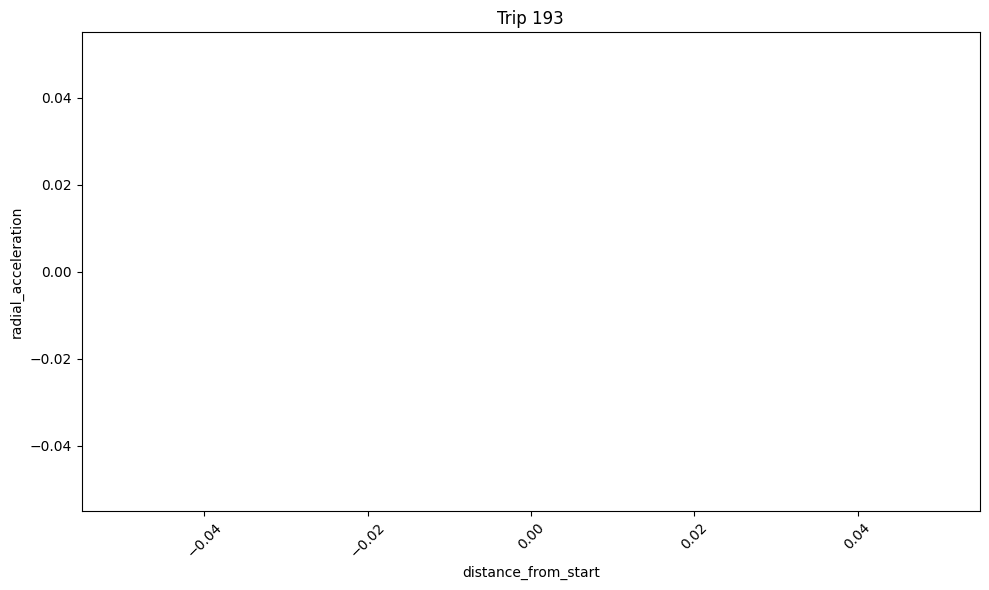

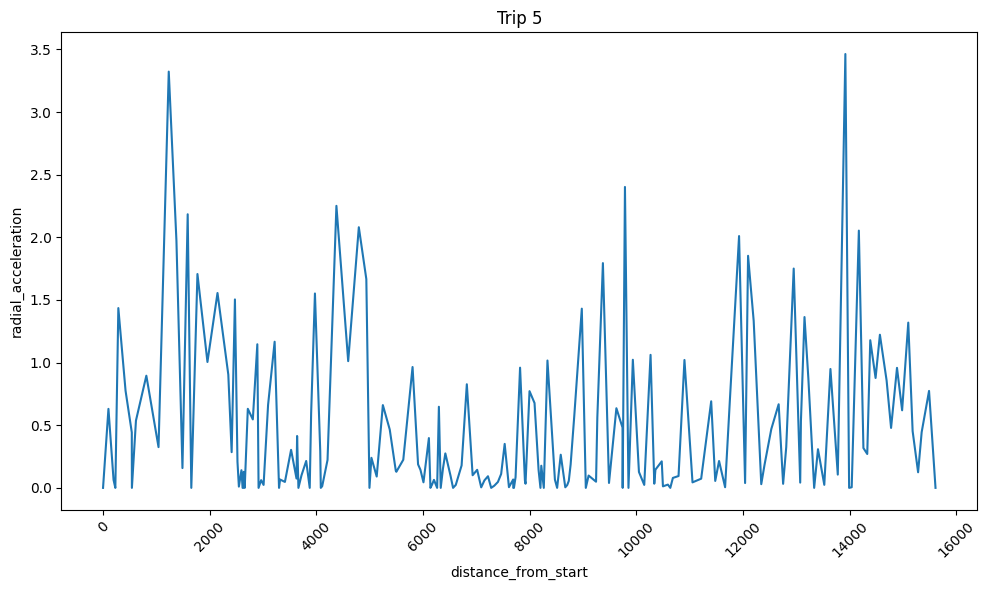

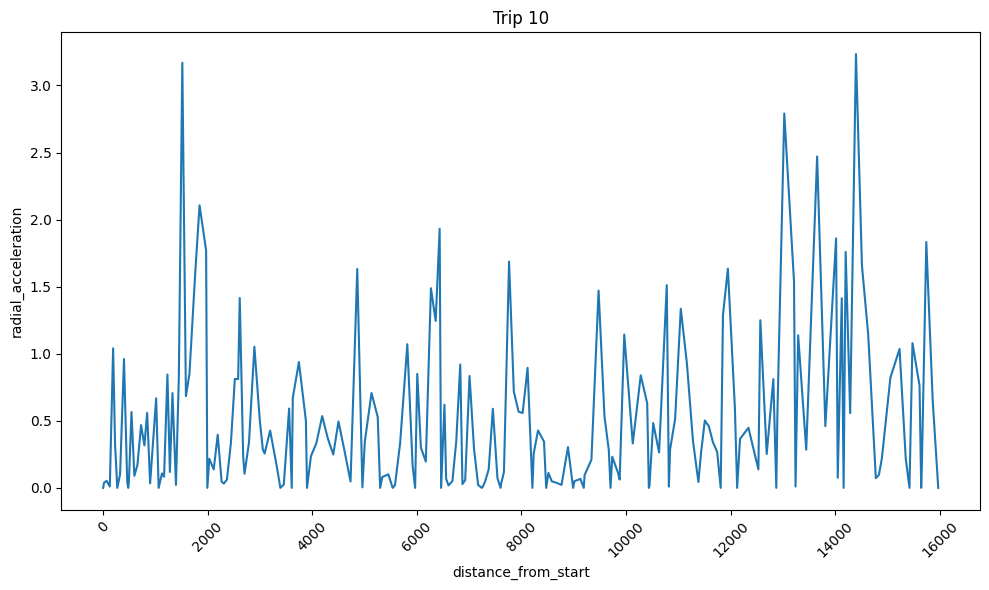

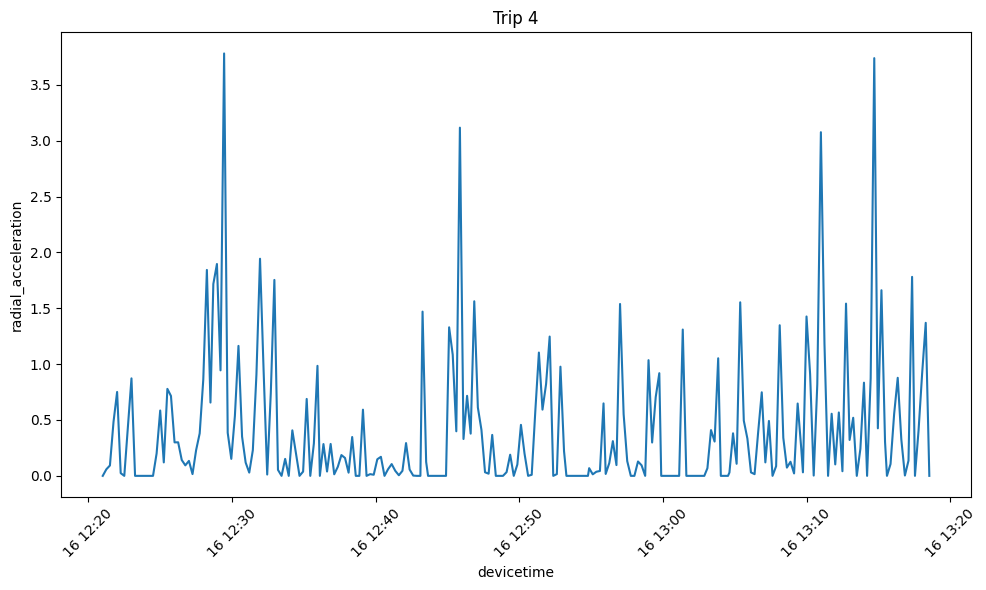

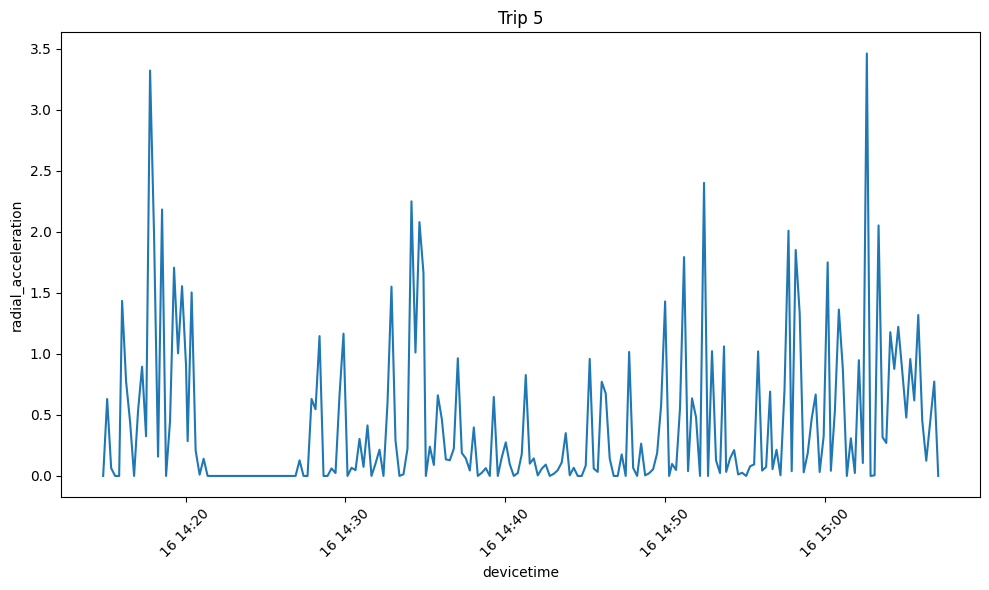

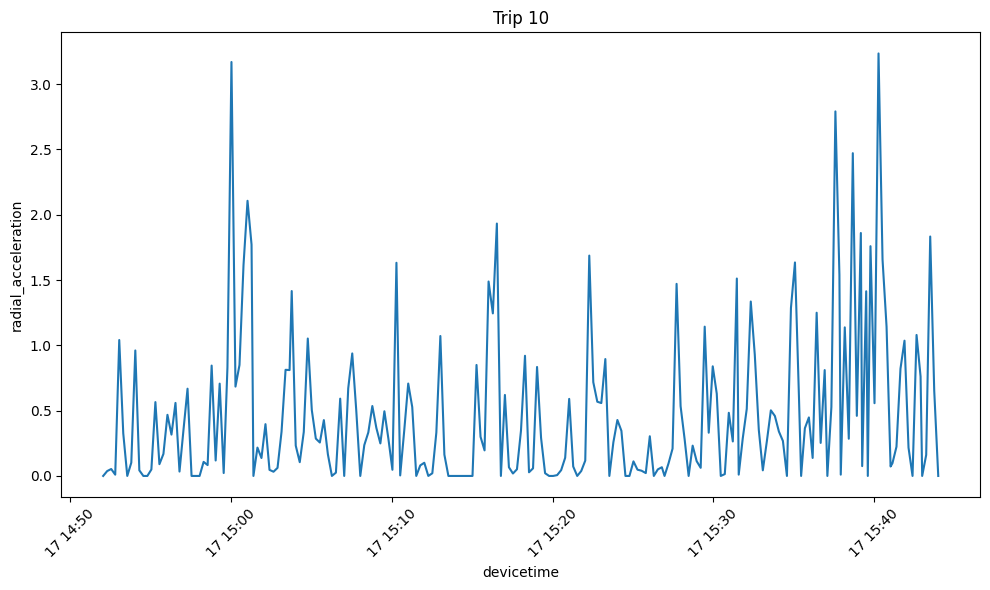

In [35]:
drawAgainst(data,193,'distance_from_start','radial_acceleration')
drawAgainst(data,5,'distance_from_start','radial_acceleration')
drawAgainst(data,10,'distance_from_start','radial_acceleration')

print("=========================================================")

drawAgainst(data,4,'devicetime','radial_acceleration')
drawAgainst(data,5,'devicetime','radial_acceleration')
drawAgainst(data,10,'devicetime','radial_acceleration')

Seem like distance is better

## Cluster Test

In [36]:
datain_one_direction=data[data['direction']==1]
data_to_cluster=datain_one_direction[['trip_id','deviceid','speed','acceleration','radial_acceleration']]

In [37]:

# from sklearn.preprocessing import LabelEncoder

# # Initialize the LabelEncoder
# label_encoder = LabelEncoder()

# # Fit and transform the 'bus_stop' column
# data_to_cluster['bus_stop'] = label_encoder.fit_transform(data_to_cluster['bus_stop'])

# # Display the encoded DataFrame
# print(data_to_cluster)


In [38]:
data_to_cluster

,trip_id,deviceid,speed,acceleration,radial_acceleration
0,2.0,116,14.03890,0.323975,0.000000
1,2.0,116,10.25920,-0.251980,1.278067
2,2.0,116,7.55940,-0.179987,0.722300
3,2.0,116,3.77970,-0.251980,0.048332
4,2.0,116,9.17927,0.359971,1.052222
...,...,...,...,...,...
144644,1364.0,1377,0.00000,-0.431965,0.000000
144645,1364.0,1377,3.77970,0.251980,0.040064
144646,1364.0,1377,9.17927,0.359971,0.955166
144647,1364.0,1377,12.95900,0.251982,1.233701


In [39]:
# group by device_id by getting the mean value of speed
# data_to_cluster_mean=data_to_cluster.groupby('deviceid')['speed'].mean().reset_index()

# reset index
data_to_cluster=data_to_cluster.reset_index(drop=True)

features_only_df = data_to_cluster[['speed', 'acceleration', 'radial_acceleration']]


In [40]:
features_only_df

,speed,acceleration,radial_acceleration
0,14.03890,0.323975,0.000000
1,10.25920,-0.251980,1.278067
2,7.55940,-0.179987,0.722300
3,3.77970,-0.251980,0.048332
4,9.17927,0.359971,1.052222
...,...,...,...
144644,0.00000,-0.431965,0.000000
144645,3.77970,0.251980,0.040064
144646,9.17927,0.359971,0.955166
144647,12.95900,0.251982,1.233701


In [41]:
# print all the column names
print(features_only_df.columns)

Index(['speed', 'acceleration', 'radial_acceleration'], dtype='object')


In [42]:
# from sklearn.cluster import KMeans
# import matplotlib.pyplot as plt

# # Assuming you have your preprocessed data in 'data_to_cluster_mean'

# # List to store distortion values
# distortions = []

# # Choose a range of cluster counts to try
# cluster_range = range(1, 11)

# # Calculate distortion for each cluster count
# for num_clusters in cluster_range:
#     kmeans = KMeans(n_clusters=num_clusters, random_state=0)
#     kmeans.fit(data_to_cluster_mean)
#     distortions.append(kmeans.inertia_)  # Inertia is the sum of squared distances to the nearest cluster center

# # Plot the elbow curve
# plt.plot(cluster_range, distortions, marker='o')
# plt.xlabel('Number of Clusters')
# plt.ylabel('Distortion')
# plt.title('Elbow Method')
# plt.show()


In [43]:
# get the number of Nan values in each column
print(features_only_df.isna().sum())

speed                  0
acceleration           0
radial_acceleration    0
dtype: int64


c:\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


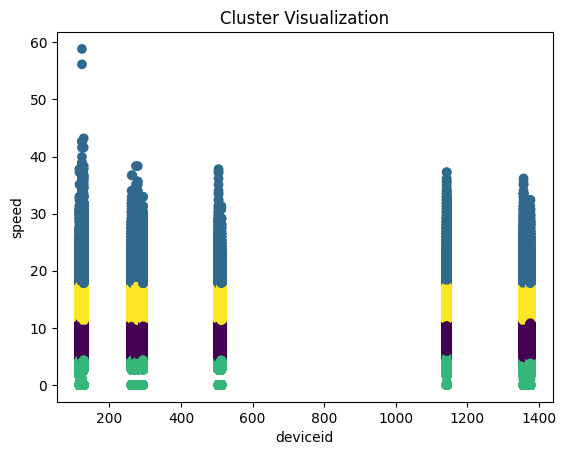

In [44]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Choose the number of clusters
num_clusters = 4

# Initialize the clustering algorithm
kmeans = KMeans(n_clusters=num_clusters, random_state=0)

# Fit the algorithm to your data
kmeans.fit(features_only_df)

# Get cluster assignments for each data point
cluster_labels = kmeans.labels_

# Get cluster centers (centroids)
cluster_centers = kmeans.cluster_centers_

# Add cluster labels to your original dataset
data_with_clusters = pd.DataFrame(features_only_df, columns=['speed', 'acceleration', 'radial_acceleration'])
data_with_clusters['cluster'] = cluster_labels
data_with_clusters['deviceid'] = data_to_cluster['deviceid']  # Add 'deviceid' column from data_to_cluster
data_with_clusters['trip_id'] = data_to_cluster['trip_id']  

# Visualize the clusters (for 2D data)
plt.scatter(data_with_clusters['deviceid'], data_with_clusters['speed'], c=cluster_labels, cmap='viridis')
plt.xlabel('deviceid')
plt.ylabel('speed')
plt.title('Cluster Visualization')
plt.show()


In [45]:
def draw_clusters(data_with_clusters,x_axis,y_axis):
    # Visualize the clusters (for 2D data)
    plt.scatter(data_with_clusters[x_axis], data_with_clusters[y_axis], c=cluster_labels, cmap='viridis')
    plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], marker='X', s=100, c='red')
    plt.xlabel(x_axis)
    plt.ylabel(y_axis)
    plt.title('Cluster Visualization')
    plt.show()


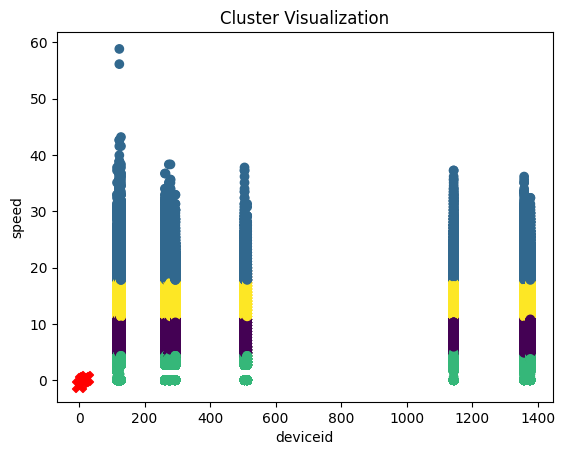

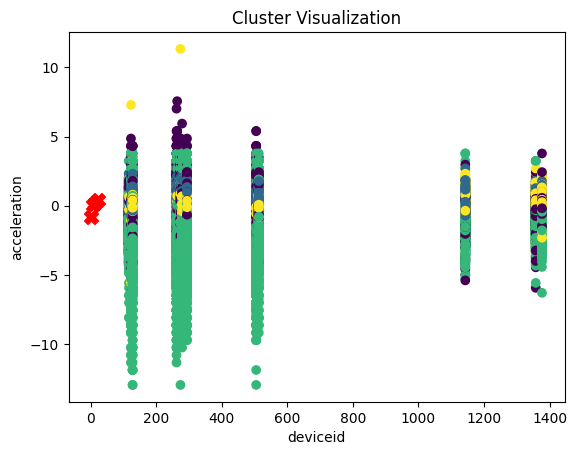

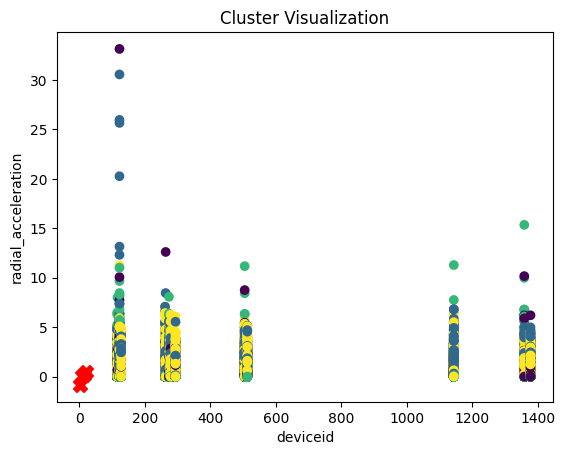

In [46]:
draw_clusters(data_with_clusters,'deviceid','speed')
draw_clusters(data_with_clusters,'deviceid','acceleration')
draw_clusters(data_with_clusters,'deviceid','radial_acceleration')

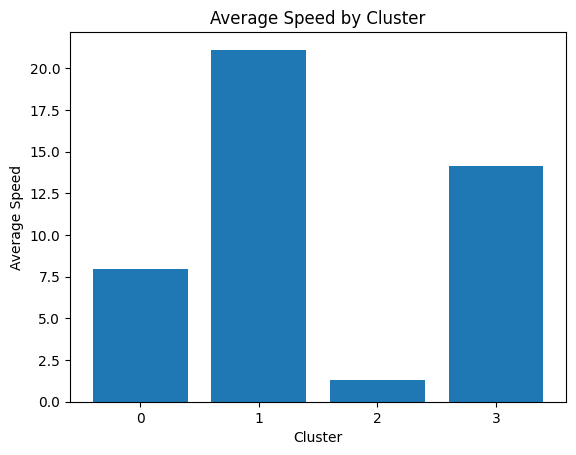

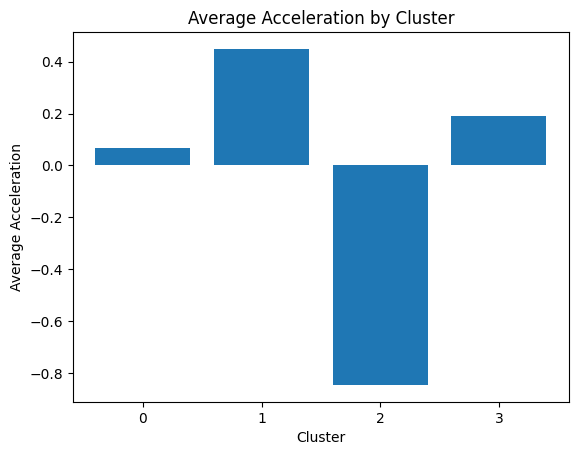

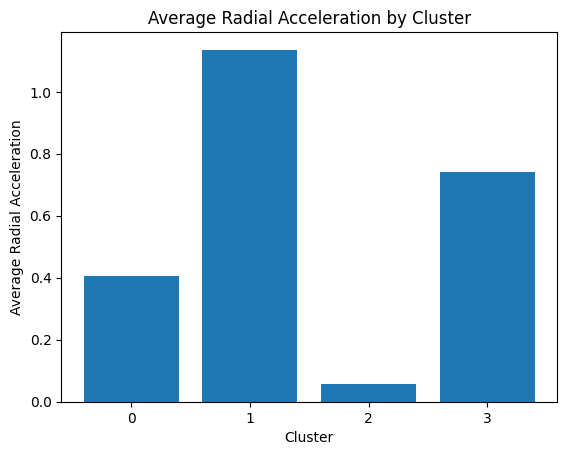

In [47]:
import matplotlib.pyplot as plt

# Calculate average values for each cluster
average_values = data_with_clusters.groupby('cluster').mean()

# Plot bar graph for Average Speed
plt.bar(average_values.index, average_values['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(average_values.index, average_values['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(average_values.index, average_values['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()


In [48]:
# create a dataframe group by device id and taking the mode of cluster column in data_with_clusters dataframe
cluster_df=data_with_clusters.groupby('deviceid')['cluster'].agg(pd.Series.mode).reset_index()

In [49]:
data_with_clusters

,speed,acceleration,radial_acceleration,cluster,deviceid,trip_id
0,14.03890,0.323975,0.000000,3,116,2.0
1,10.25920,-0.251980,1.278067,0,116,2.0
2,7.55940,-0.179987,0.722300,0,116,2.0
3,3.77970,-0.251980,0.048332,2,116,2.0
4,9.17927,0.359971,1.052222,0,116,2.0
...,...,...,...,...,...,...
144644,0.00000,-0.431965,0.000000,2,1377,1364.0
144645,3.77970,0.251980,0.040064,2,1377,1364.0
144646,9.17927,0.359971,0.955166,0,1377,1364.0
144647,12.95900,0.251982,1.233701,3,1377,1364.0


In [50]:
cluster_df


,deviceid,cluster
0,116,0
1,117,2
2,123,2
3,128,2
4,262,2
5,264,2
6,274,2
7,279,2
8,294,2
9,505,2


In [51]:
data

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start
0,574733099,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,POINT (184841.00784031872 232320.15459256113),NaN,2.0,1,0.323975,0.000000,0.000000
1,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485
2,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397
3,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339
4,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
289611,585350956,1377,2021-10-27 19:02:53,7.290715,80.638227,5.39957,2021-10-27,19:02:53,POINT (185039.30275057122 232059.86188720367),NaN,1365.0,2,-0.431969,0.096208,15343.107522
289612,585350957,1377,2021-10-27 19:03:08,7.291095,80.637743,8.09935,2021-10-27,19:03:08,POINT (184985.95129993305 232101.89901670374),NaN,1365.0,2,0.179985,0.322474,15411.129104
289613,585351802,1377,2021-10-27 19:03:23,7.291273,80.637273,5.39957,2021-10-27,19:03:23,POINT (184934.06182375905 232121.63129080654),NaN,1365.0,2,-0.179985,0.144867,15466.630070
289614,585351803,1377,2021-10-27 19:03:38,7.291202,80.636218,18.89850,2021-10-27,19:03:38,POINT (184817.57099444696 232113.7373533016),NaN,1365.0,2,0.899929,1.215854,15583.264936


In [52]:
# in data dataframe, select all the raws within a given date around a 5 minitues time interval around a given time
data['devicetime']=pd.to_datetime(data['devicetime'])

# Given date and time
given_date = '2021-10-16'
given_time = '08:03:04'

# Convert given time to datetime format
given_datetime = pd.to_datetime('2021-10-27 14:50:45')

# Calculate time range for the interval
time_range = pd.to_timedelta('1 minutes')

# Filter rows within the time interval around the given time
selected_rows = data[
    (data['devicetime'] >= (given_datetime - time_range)) &
    (data['devicetime'] <= (given_datetime + time_range))
]




In [53]:
selected_rows

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start
86775,585058891,279,2021-10-27 14:49:46,7.294113,80.725613,22.67820,2021-10-27,14:49:46,POINT (194688.19368055704 232433.73444997016),NaN,819.0,1,-0.036000,0.691366,14735.350488
86776,585058890,279,2021-10-27 14:50:01,7.294483,80.727097,19.97840,2021-10-27,14:50:01,POINT (194851.97574860882 232474.63339936035),NaN,819.0,1,-0.179987,0.144281,14904.045002
86777,585058093,279,2021-10-27 14:50:16,7.294692,80.728167,10.25920,2021-10-27,14:50:16,POINT (194970.12152812158 232497.65612899073),NaN,819.0,1,-0.647947,0.198483,15024.312031
86778,585058092,279,2021-10-27 14:50:31,7.294913,80.728738,6.47948,2021-10-27,14:50:31,POINT (195033.24782492692 232522.16614879473),NaN,819.0,1,-0.251981,0.158246,15092.015249
86779,585058090,279,2021-10-27 14:50:46,7.295215,80.729172,7.01944,2021-10-27,14:50:46,POINT (195081.09354342122 232555.5242618176),NaN,819.0,1,0.035997,0.058552,15150.405246
86780,585058089,279,2021-10-27 14:51:01,7.295588,80.729632,10.25920,2021-10-27,14:51:01,POINT (195131.88799746314 232596.7998306298),NaN,819.0,1,0.215984,0.323920,15215.957537
86781,585058088,279,2021-10-27 14:51:16,7.296093,80.730038,9.71923,2021-10-27,14:51:16,POINT (195176.79863694706 232652.6396692701),NaN,819.0,1,-0.035998,0.011669,15287.827867
86782,585058085,279,2021-10-27 14:51:29,7.296557,80.730405,0.00000,2021-10-27,14:51:29,POINT (195217.2921930094 232703.86867577233),NaN,819.0,1,-0.747633,0.000000,15353.324123
289190,585060870,1377,2021-10-27 14:51:00,7.298748,80.733618,8.63931,2021-10-27,14:51:00,POINT (195572.1060465019 232946.20045162784),NaN,1363.0,2,0.323974,0.000000,0.000000
289191,585060872,1377,2021-10-27 14:51:15,7.298258,80.733123,8.63931,2021-10-27,14:51:15,POINT (195517.44673514328 232892.019819969),NaN,1363.0,2,0.000000,0.466397,77.131985


## Time serious cluster test

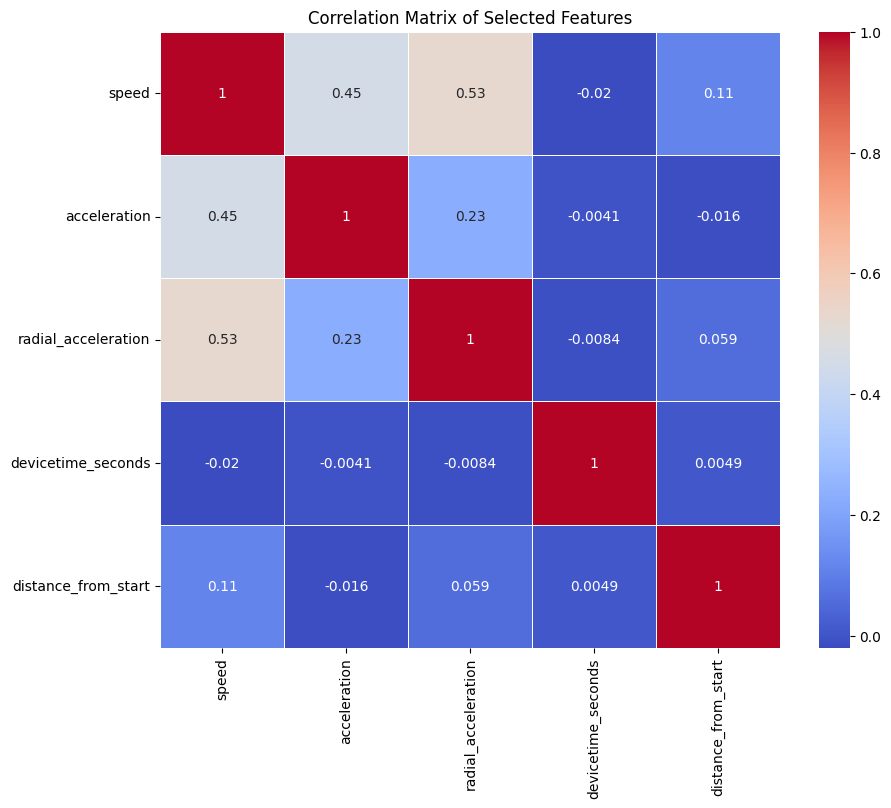

In [54]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load your dataset (assuming it's named 'data')
# data = pd.read_csv('your_dataset.csv')

# Convert 'devicetime' to pandas Timestamp
data['devicetime'] = pd.to_datetime(data['devicetime'])

# Convert 'devicetime' to seconds
data['devicetime_seconds'] = (data['devicetime'] - data['devicetime'].min()).dt.total_seconds()

# Select the features for correlation matrix
selected_features = ['speed', 'acceleration', 'radial_acceleration', 'devicetime_seconds','distance_from_start']

# Calculate the correlation matrix
correlation_matrix = data[selected_features].corr()

# Create a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=.5)
plt.title("Correlation Matrix of Selected Features")
plt.show()


In [55]:
from sklearn.preprocessing import StandardScaler

# Create empty lists to store trip IDs and dataframes
processed_trip_ids = []
dataframes_without_trip_id = []

# Iterate through each unique trip_id
for trip_id in datain_one_direction['trip_id'].unique():
    # Filter the data for the current trip_id
    trip_data = datain_one_direction[datain_one_direction['trip_id'] == trip_id].copy()
    
    # Remove the trip_id column from the current trip_data
    trip_data_without_id = trip_data[['devicetime', 'radial_acceleration','speed', 'acceleration','distance_from_start']]
    
    # Ensure selected columns are numeric (e.g., exclude any object or string columns)
    numeric_columns = [ 'radial_acceleration','speed', 'acceleration','distance_from_start']
    trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
    
    # # Initialize the StandardScaler
    # scaler = StandardScaler()
    
    # columns_to_scale = ['radial_acceleration']

    # # Fit and transform the selected columns
    # trip_data_without_id[columns_to_scale] = scaler.fit_transform(trip_data_without_id[columns_to_scale])
    

    # Append the trip_id to the list
    processed_trip_ids.append(trip_id)
    
    # Append the dataframe without trip_id to the list
    dataframes_without_trip_id.append(trip_data_without_id)

# Print the processed trip IDs and the first few rows of each dataframe
for trip_id, df in zip(processed_trip_ids, dataframes_without_trip_id):
    print(f"Processed Trip ID: {trip_id}")
    print(df.head())  # Print the first few rows of the dataframe
    print("\n")


C:\Users\gw\AppData\Local\Temp\ipykernel_19624\2638954082.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_19624\2638954082.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trip_data_without_id [numeric_columns]= trip_data_without_id[numeric_columns].astype(float)  # Convert to float data type
C:\Users\gw\AppData\Local\Temp\ipykernel_19624

Processed Trip ID: 2.0
           devicetime  radial_acceleration     speed  acceleration  \
0 2021-10-16 08:03:19             0.000000  14.03890      0.323975   
1 2021-10-16 08:03:34             1.278067  10.25920     -0.251980   
2 2021-10-16 08:03:49             0.722300   7.55940     -0.179987   
3 2021-10-16 08:04:04             0.048332   3.77970     -0.251980   
4 2021-10-16 08:04:19             1.052222   9.17927      0.359971   

   distance_from_start  
0             0.000000  
1           123.738485  
2           163.044397  
3           211.472339  
4           287.492821  


Processed Trip ID: 4.0
             devicetime  radial_acceleration    speed  acceleration  \
206 2021-10-16 12:21:00             0.000000  0.00000     -0.395969   
207 2021-10-16 12:21:15             0.058599  7.01944      0.467963   
208 2021-10-16 12:21:30             0.092952  9.71923      0.179986   
209 2021-10-16 12:21:45             0.483596  8.63931     -0.071995   
210 2021-10-16 12:22:00   

In [56]:
dataframes_without_trip_id[1]

,devicetime,radial_acceleration,speed,acceleration,distance_from_start
206,2021-10-16 12:21:00,0.000000,0.00000,-0.395969,0.000000
207,2021-10-16 12:21:15,0.058599,7.01944,0.467963,40.639631
208,2021-10-16 12:21:30,0.092952,9.71923,0.179986,110.740656
209,2021-10-16 12:21:45,0.483596,8.63931,-0.071995,193.101564
210,2021-10-16 12:22:00,0.751005,4.85961,-0.251980,236.850009
...,...,...,...,...,...
438,2021-10-16 13:17:33,0.000000,0.00000,-1.529875,15616.015197
439,2021-10-16 13:17:48,0.405917,8.63931,0.575954,15644.008931
440,2021-10-16 13:18:03,0.916469,15.11880,0.431966,15733.065369
441,2021-10-16 13:18:18,1.369753,14.57880,-0.036000,15855.685329


In [57]:
# delete rows with duplicate distance_from_start values in each data frames in dataframes_without_trip_id list
for df in dataframes_without_trip_id:
    df.drop_duplicates(subset=['distance_from_start'], keep='first', inplace=True)

C:\Users\gw\AppData\Local\Temp\ipykernel_19624\2356658688.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop_duplicates(subset=['distance_from_start'], keep='first', inplace=True)


In [58]:
df

,devicetime,radial_acceleration,speed,acceleration,distance_from_start
144426,2021-10-27 16:31:12,0.000000,9.17927,0.215983,0.000000
144427,2021-10-27 16:31:27,0.083882,9.71923,0.035997,82.975132
144428,2021-10-27 16:31:42,0.544436,5.39957,-0.287977,149.895468
144429,2021-10-27 16:31:57,0.000000,0.00000,-0.359971,162.293625
144430,2021-10-27 16:32:12,0.328044,7.01944,0.467963,215.381619
...,...,...,...,...,...
144644,2021-10-27 17:24:17,0.000000,0.00000,-0.431965,15556.443059
144645,2021-10-27 17:24:32,0.040064,3.77970,0.251980,15568.142342
144646,2021-10-27 17:24:47,0.955166,9.17927,0.359971,15631.694772
144647,2021-10-27 17:25:02,1.233701,12.95900,0.251982,15739.603572


In [59]:
# Assuming dataframes_without_trip_id is a list of dataframes with 'devicetime' column
for df in dataframes_without_trip_id:
    df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
    
    # Calculate time difference in seconds since trip start
    df['devicetime'] = (df['devicetime'] - df['devicetime'].min()).dt.total_seconds()

    # Print the updated dataframe
    print(df)

     devicetime  radial_acceleration     speed  acceleration  \
0           0.0             0.000000  14.03890      0.323975   
1          15.0             1.278067  10.25920     -0.251980   
2          30.0             0.722300   7.55940     -0.179987   
3          45.0             0.048332   3.77970     -0.251980   
4          60.0             1.052222   9.17927      0.359971   
..          ...                  ...       ...           ...   
201      2969.0             0.000000   0.00000     -0.791940   
202      2984.0             0.481587   7.55940      0.503960   
203      2999.0             0.155985  15.11880      0.503960   
204      3014.0             1.672843  18.35850      0.215980   
205      3029.0             0.000000   4.85961     -0.899926   

     distance_from_start  
0               0.000000  
1             123.738485  
2             163.044397  
3             211.472339  
4             287.492821  
..                   ...  
201         15567.990545  
202         156

C:\Users\gw\AppData\Local\Temp\ipykernel_19624\3500269481.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['devicetime'] = pd.to_datetime(df['devicetime'])  # Convert to datetime if not already
C:\Users\gw\AppData\Local\Temp\ipykernel_19624\3500269481.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['devicetime'] = (df['devicetime'] - df['devicetime'].min()).dt.total_seconds()


In [60]:
dataframes_without_trip_id[2].head(20)

,devicetime,radial_acceleration,speed,acceleration,distance_from_start
443,0.0,0.000000,0.00000,-0.467963,0.000000
444,15.0,0.207373,6.47948,0.431965,22.809853
445,30.0,0.097039,5.93953,-0.035997,85.025496
446,45.0,0.014021,8.09935,0.143988,157.635054
447,60.0,0.000000,0.00000,-0.539957,203.417153
448,75.0,0.888259,5.39957,0.359971,235.580231
449,90.0,0.039453,4.31966,-0.071994,281.142239
450,105.0,0.410817,8.63931,0.287977,352.469453
451,120.0,1.506472,9.71923,0.071995,417.108821
452,135.0,0.000000,0.00000,-0.647949,471.350128


In [61]:
bus_trips

,trip_id,deviceid,date,start_terminal,end_terminal,direction,start_time,end_time,duration,duration_in_mins,day_of_week,hour_of_day
0,1.0,116,2021-10-16,BT02,BT01,2,07:08:31,07:53:04,0:44:33,44.550000,5,7
1,2.0,116,2021-10-16,BT01,BT02,1,08:03:04,08:53:48,0:50:44,50.733333,5,8
2,3.0,116,2021-10-16,BT02,BT01,2,10:50:19,11:44:43,0:54:24,54.400000,5,10
3,4.0,116,2021-10-16,BT01,BT02,1,12:20:45,13:18:33,0:57:48,57.800000,5,12
4,5.0,116,2021-10-16,BT02,BT01,2,14:14:36,15:07:05,0:52:29,52.483333,5,14
...,...,...,...,...,...,...,...,...,...,...,...,...
1360,1361.0,1377,2021-10-27,BT02,BT01,2,10:40:37,11:38:13,0:57:36,57.600000,2,10
1361,1362.0,1377,2021-10-27,BT01,BT02,1,12:21:26,13:17:50,0:56:24,56.400000,2,12
1362,1363.0,1377,2021-10-27,BT02,BT01,2,14:50:45,15:42:42,0:51:57,51.950000,2,14
1363,1364.0,1377,2021-10-27,BT01,BT02,1,16:30:57,17:25:17,0:54:20,54.333333,2,16


In [62]:
# sort bus_trips dataframe by duration_in_mins , in dessending order
bus_trips.sort_values(by=['duration_in_mins'], ascending=False, inplace=True)

In [63]:
bus_trips.head(40)

,trip_id,deviceid,date,start_terminal,end_terminal,direction,start_time,end_time,duration,duration_in_mins,day_of_week,hour_of_day
192,193.0,123,2021-10-23,BT01,BT02,1,06:01:11,13:35:40,7:34:29,454.483333,5,6
234,235.0,123,2021-11-01,BT01,BT02,1,05:34:51,12:15:58,6:41:07,401.116667,0,5
206,207.0,123,2021-10-26,BT01,BT02,1,19:25:38,23:33:07,4:07:29,247.483333,1,19
140,141.0,123,2021-10-11,BT02,BT01,2,14:33:21,18:37:22,4:04:01,244.016667,0,14
146,147.0,123,2021-10-12,BT02,BT01,2,15:02:30,18:29:29,3:26:59,206.983333,1,15
165,166.0,123,2021-10-18,BT01,BT02,1,05:03:06,08:07:15,3:04:09,184.150000,0,5
152,153.0,123,2021-10-13,BT02,BT01,2,15:33:51,18:31:41,2:57:50,177.833333,2,15
205,206.0,123,2021-10-26,BT02,BT01,2,15:48:31,18:41:55,2:53:24,173.400000,1,15
194,195.0,123,2021-10-23,BT01,BT02,1,19:02:55,21:47:03,2:44:08,164.133333,5,19
189,190.0,123,2021-10-22,BT02,BT01,2,16:28:47,19:10:48,2:42:01,162.016667,4,16


In [64]:
# #### Interpolate Device time #####


# import numpy as np
# import pandas as pd
# from scipy.interpolate import interp1d

# # Assume you have a list of dataframes with 'devicetime' and other features
# dataframes = dataframes_without_trip_id  # List of dataframes

# # Step 1: Identify the maximum time duration across all dataframes
# max_duration = max(df['devicetime'].max() for df in dataframes)

# # Step 2: Define a common time interval (e.g., 15 seconds)
# common_time_interval = 15

# # Create a new dataframe with uniform devicetime values
# new_time_values = np.arange(0, max_duration, common_time_interval)
# new_time_df = pd.DataFrame({'devicetime': new_time_values})

# # Step 3 and 4: Interpolate other features for each dataframe
# interpolated_dataframes = []
# for df in dataframes:
#     # Merge the new_time_df with the current dataframe based on 'devicetime'
#     merged_df = pd.merge(new_time_df, df, on='devicetime', how='left')
    
#     # Interpolate other features using linear interpolation
#     features_to_interpolate = df.columns.difference(['devicetime'])
#     for feature in features_to_interpolate:
#         interpolator = interp1d(merged_df['devicetime'], merged_df[feature], kind='linear', fill_value='extrapolate')
#         merged_df[feature] = interpolator(new_time_values)
#         #fill null values
#         merged_df[feature].fillna(0, inplace=True)
    
#     interpolated_dataframes.append(merged_df)

# # Now, interpolated_dataframes contains dataframes with uniform devicetime and interpolated features


In [65]:
import numpy as np
import pandas as pd
from scipy.interpolate import interp1d

# Assume you have a list of dataframes with 'distance_from_start' and other features
dataframes = dataframes_without_trip_id  # List of dataframes

# Step 1: Identify the maximum distance_from_start value across all dataframes
max_distance = max(df['distance_from_start'].max() for df in dataframes)

# Step 2: Define a common distance interval (e.g., 100 meters)
common_distance_interval = 50

# Create a new dataframe with uniform distance_from_start values
new_distance_values = np.arange(0, max_distance, common_distance_interval)
new_distance_df = pd.DataFrame({'distance_from_start': new_distance_values})

# Step 3 and 4: Interpolate other features for each dataframe
interpolated_dataframes = []
for df in dataframes:
    # Merge the new_distance_df with the current dataframe based on 'distance_from_start'
    merged_df = pd.merge(new_distance_df, df, on='distance_from_start', how='left')
    
    # Interpolate other features using linear interpolation
    features_to_interpolate = df.columns.difference(['distance_from_start'])
    # Loop through the features and interpolate
    for feature in features_to_interpolate:
        interpolator = interp1d(df['distance_from_start'], df[feature], kind='linear', fill_value='extrapolate')
        interpolated_values = interpolator(new_distance_values)
        
        # Create a mask for values beyond the range of the original data
        mask = (new_distance_values < df['distance_from_start'].min()) | (new_distance_values > df['distance_from_start'].max())
        
        # Set values outside the original data range to 0
        interpolated_values[mask] = 0
        
        # Add the interpolated values as a new column to the merged_df
        merged_df[feature] = interpolated_values
        
    merged_df.drop(['devicetime'], axis=1, inplace=True)
    interpolated_dataframes.append(merged_df)

# Now, interpolated_dataframes contains dataframes with uniform distance_from_start and interpolated features


In [66]:
interpolated_dataframes[1]

,distance_from_start,radial_acceleration,speed,acceleration
0,0.0,0.000000,0.000000,-0.395969
1,50.0,0.063186,7.379934,0.429510
2,100.0,0.087689,9.305577,0.224109
3,150.0,0.279162,9.204460,0.059873
4,200.0,0.525762,8.043311,-0.100376
...,...,...,...,...
390,19500.0,0.000000,0.000000,0.000000
391,19550.0,0.000000,0.000000,0.000000
392,19600.0,0.000000,0.000000,0.000000
393,19650.0,0.000000,0.000000,0.000000


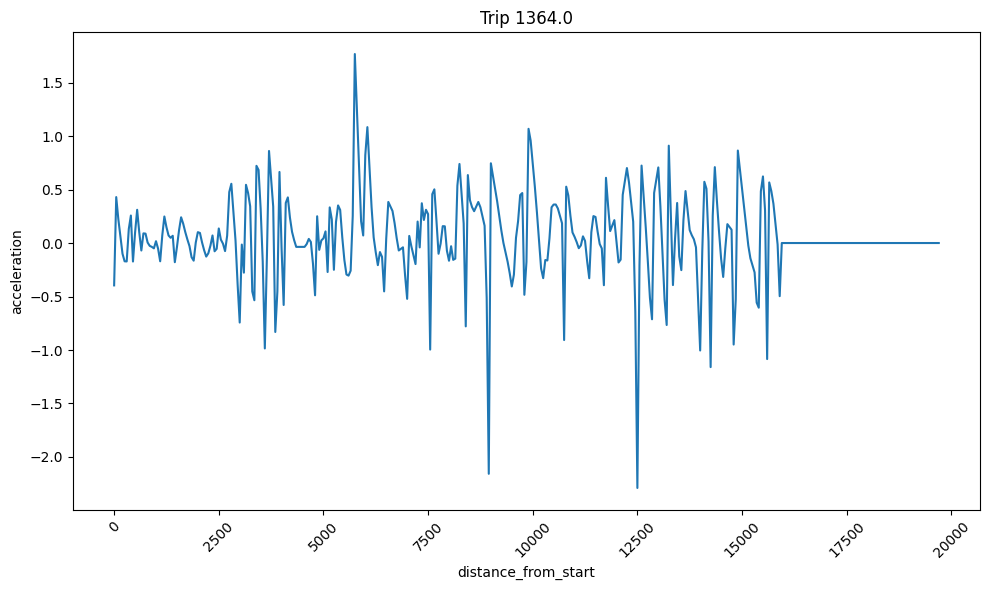

In [67]:
columnx='distance_from_start'
columny='acceleration'

trip_df = interpolated_dataframes[1]
plt.figure(figsize=(10, 6))  # Adjust figure size as needed
plt.plot(trip_df[f"{columnx}"], trip_df[f"{columny}"])
plt.xlabel(f"{columnx}")
plt.ylabel(f"{columny}")
plt.title("Trip " + str(trip_id))
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.tight_layout()  # Adjust layout for better formatting
plt.show()

In [68]:
interpolated_dataframes[23]

,distance_from_start,radial_acceleration,speed,acceleration
0,0.0,0.000000,2.159830,-0.287977
1,50.0,0.030014,5.661390,0.290152
2,100.0,0.051443,6.444581,0.081300
3,150.0,0.699868,7.949785,0.130806
4,200.0,1.160907,9.179270,0.148199
...,...,...,...,...
390,19500.0,0.000000,0.000000,0.000000
391,19550.0,0.000000,0.000000,0.000000
392,19600.0,0.000000,0.000000,0.000000
393,19650.0,0.000000,0.000000,0.000000


In [69]:
len(interpolated_dataframes[1])

395

In [70]:
# get the number of columns in dataframes_without_trip_id
num_columns = len(interpolated_dataframes[0].columns)
num_columns

4

In [71]:
# get a list of column names in interpolated_dataframes
column_namesInter = interpolated_dataframes[1].columns
#make it to a string list of names 
column_namesInter = column_namesInter.tolist()
column_namesInter

['distance_from_start', 'radial_acceleration', 'speed', 'acceleration']

c:\Python311\Lib\site-packages\tslearn\bases\bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


1071.600 --> 602.311 --> 598.599 --> 597.893 --> 597.243 --> 596.378 --> 595.201 --> 593.045 --> 592.121 --> 591.228 --> 590.817 --> 589.368 --> 587.987 --> 587.845 --> 587.804 --> 587.793 --> 587.779 --> 587.755 --> 587.718 --> 587.691 --> 587.682 --> 587.682 --> 


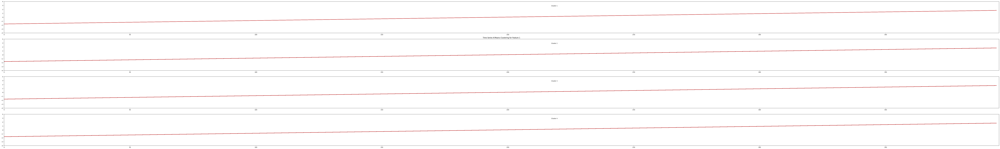

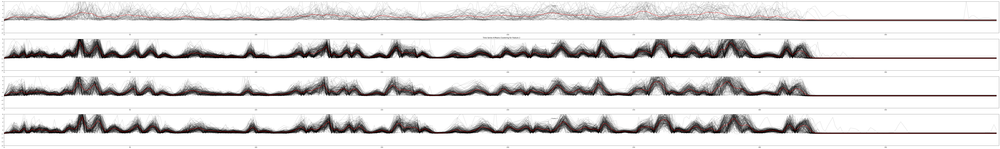

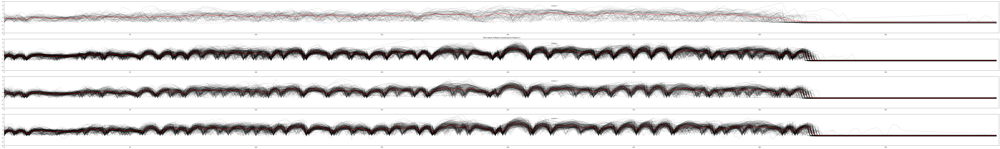

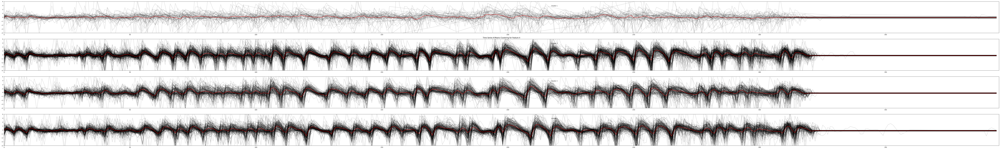

In [72]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler

# Convert your list of dataframes to a 3D numpy array
n_ts = len(interpolated_dataframes)
sz = interpolated_dataframes[0].shape[0]
d = interpolated_dataframes[0].shape[1]
data_3d = np.array([df.values for df in interpolated_dataframes])

# Perform preprocessing on the data
X_train = TimeSeriesScalerMeanVariance().fit_transform(data_3d)
X_train = TimeSeriesResampler(sz=sz).fit_transform(X_train)
sz = X_train.shape[1]

# Perform TimeSeriesKMeans clustering
cluster_count = 4
seed = 1234
km = TimeSeriesKMeans(n_clusters=cluster_count, verbose=True, random_state=seed)
y_pred = km.fit_predict(X_train)

# Iterate through each feature and visualize the clusters
for feature_idx in range(X_train.shape[2]):
    plt.figure(figsize=(100, 15))
    for yi in range(cluster_count):
        plt.subplot(cluster_count, 1, yi + 1)
        for xx in X_train[y_pred == yi, :, feature_idx]:
            plt.plot(xx.ravel(), "k-", alpha=0.2)
        plt.plot(km.cluster_centers_[yi, :, feature_idx].ravel(), "r-")
        plt.xlim(0, sz)
        plt.ylim(-4, 4)
        plt.text(0.55, 0.85, f'Cluster {yi + 1}', transform=plt.gca().transAxes)
        if yi == 1:
            plt.title(f"Time Series K-Means Clustering for Feature {feature_idx + 1}")
    plt.tight_layout()
    plt.show()


### Cluster data Visualize

In [73]:
type(y_pred)

numpy.ndarray

In [74]:
# convert processed_trip_ids to a numpy array
processed_trip_ids = np.array(processed_trip_ids)

In [75]:
# create a data frame from processed_trip_ids and y_pred , and rename the columns to 'trip_id' and 'cluster'
trip_clusters = pd.DataFrame({'trip_id': processed_trip_ids, 'TScluster': y_pred})

In [76]:
trip_clusters

,trip_id,TScluster
0,2.0,2
1,4.0,1
2,6.0,3
3,8.0,1
4,10.0,1
...,...,...
664,1356.0,1
665,1358.0,1
666,1360.0,3
667,1362.0,1


In [86]:
datain_one_direction

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start
0,574733099,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,POINT (184841.00784031872 232320.15459256113),NaN,2.0,1,0.323975,0.000000,0.000000
1,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485
2,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397
3,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339
4,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144644,585256700,1377,2021-10-27 17:24:17,7.297480,80.732092,0.00000,2021-10-27,17:24:17,POINT (195403.52545714873 232805.9635712482),NaN,1364.0,1,-0.431965,0.000000,15556.443059
144645,585256702,1377,2021-10-27 17:24:32,7.297510,80.732193,3.77970,2021-10-27,17:24:32,POINT (195414.75483010974 232809.26899391826),NaN,1364.0,1,0.251980,0.040064,15568.142342
144646,585256704,1377,2021-10-27 17:24:47,7.297613,80.732760,9.17927,2021-10-27,17:24:47,POINT (195477.32731263872 232820.69775065468),NaN,1364.0,1,0.359971,0.955166,15631.694772
144647,585256706,1377,2021-10-27 17:25:02,7.298523,80.733100,12.95900,2021-10-27,17:25:02,POINT (195514.8655653549 232921.3243238285),NaN,1364.0,1,0.251982,1.233701,15739.603572


In [124]:
data_with_clusters

,speed,acceleration,radial_acceleration,cluster,deviceid,trip_id
0,14.03890,0.323975,0.000000,3,116,2.0
1,10.25920,-0.251980,1.278067,0,116,2.0
2,7.55940,-0.179987,0.722300,0,116,2.0
3,3.77970,-0.251980,0.048332,2,116,2.0
4,9.17927,0.359971,1.052222,0,116,2.0
...,...,...,...,...,...,...
144644,0.00000,-0.431965,0.000000,2,1377,1364.0
144645,3.77970,0.251980,0.040064,2,1377,1364.0
144646,9.17927,0.359971,0.955166,0,1377,1364.0
144647,12.95900,0.251982,1.233701,3,1377,1364.0


In [132]:
norm_clusters=pd.DataFrame({'trip_id': data_with_clusters['trip_id'], 'NormCluster': data_with_clusters['cluster']})

In [133]:
norm_clusters = norm_clusters.groupby('trip_id')['NormCluster'].apply(lambda x: stats.mode(x)[0][0]).reset_index()
norm_clusters

C:\Users\gw\AppData\Local\Temp\ipykernel_19624\3080661371.py:1: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  norm_clusters = norm_clusters.groupby('trip_id')['NormCluster'].apply(lambda x: stats.mode(x)[0][0]).reset_index()


,trip_id,NormCluster
0,2.0,3
1,4.0,2
2,6.0,2
3,8.0,3
4,10.0,0
...,...,...
664,1356.0,3
665,1358.0,3
666,1360.0,3
667,1362.0,3


In [137]:
cluster_data = pd.DataFrame()

cluster_data = datain_one_direction[['trip_id', 'deviceid', 'speed', 'acceleration', 'radial_acceleration', 'distance_from_start']]

# Perform a left merge based on 'trip_id'
cluster_data = pd.merge(cluster_data, trip_clusters, on='trip_id', how='left')

cluster_data = pd.merge(cluster_data, norm_clusters, on='trip_id', how='left')

In [138]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,14.03890,0.323975,0.000000,0.000000,2,3
1,2.0,116,10.25920,-0.251980,1.278067,123.738485,2,3
2,2.0,116,7.55940,-0.179987,0.722300,163.044397,2,3
3,2.0,116,3.77970,-0.251980,0.048332,211.472339,2,3
4,2.0,116,9.17927,0.359971,1.052222,287.492821,2,3
...,...,...,...,...,...,...,...,...
144644,1364.0,1377,0.00000,-0.431965,0.000000,15556.443059,2,2
144645,1364.0,1377,3.77970,0.251980,0.040064,15568.142342,2,2
144646,1364.0,1377,9.17927,0.359971,0.955166,15631.694772,2,2
144647,1364.0,1377,12.95900,0.251982,1.233701,15739.603572,2,2


In [139]:
cluster_data.dropna(inplace=True)

In [140]:
cluster_data.groupby('trip_id').mean()

,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
trip_id,,,,,,,
2.0,116.0,9.706123,-0.028592,0.483827,7409.855387,2.0,3.0
4.0,116.0,8.245167,-0.024723,0.401335,7450.208751,1.0,2.0
6.0,116.0,8.495174,-0.028923,0.421818,7583.642726,3.0,2.0
8.0,116.0,9.572668,-0.033368,0.526471,7145.894234,1.0,3.0
10.0,116.0,9.485664,-0.060823,0.470724,7148.874648,1.0,0.0
...,...,...,...,...,...,...,...
1356.0,1377.0,8.933183,-0.008797,0.417960,7484.019662,1.0,3.0
1358.0,1377.0,11.628908,-0.017242,0.616041,6983.816521,1.0,3.0
1360.0,1377.0,10.256430,-0.025723,0.520143,7372.851844,3.0,3.0


In [141]:
data_with_clusters

,speed,acceleration,radial_acceleration,cluster,deviceid,trip_id
0,14.03890,0.323975,0.000000,3,116,2.0
1,10.25920,-0.251980,1.278067,0,116,2.0
2,7.55940,-0.179987,0.722300,0,116,2.0
3,3.77970,-0.251980,0.048332,2,116,2.0
4,9.17927,0.359971,1.052222,0,116,2.0
...,...,...,...,...,...,...
144644,0.00000,-0.431965,0.000000,2,1377,1364.0
144645,3.77970,0.251980,0.040064,2,1377,1364.0
144646,9.17927,0.359971,0.955166,0,1377,1364.0
144647,12.95900,0.251982,1.233701,3,1377,1364.0


In [142]:
#Group by 'TScluster' and calculate the mean of each feature
TSclusgrped=cluster_data.groupby('TScluster').mean()


# #Group by 'NormCluster' and calculate the mean of each feature
NormClustGrped=cluster_data.groupby('NormCluster').mean()


In [143]:
TSclusgrped

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,NormCluster
TScluster,,,,,,,
0,484.620013,329.592203,9.902792,-0.134702,0.505285,7075.960802,1.937362
1,727.608550,518.086193,9.111332,-0.153524,0.472580,7415.324536,1.938351
2,678.805172,482.053798,9.772071,-0.151293,0.511250,7407.881460,2.008338
3,673.067922,534.959618,8.772941,-0.130986,0.459133,7359.662223,1.883098


In [144]:
NormClustGrped

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster
NormCluster,,,,,,,
0,621.516769,566.129820,9.224581,-0.090658,0.467788,7368.549034,1.897194
1,504.491194,319.544888,13.401976,-0.196243,0.751161,7096.561365,1.531357
2,637.327944,397.256318,8.726507,-0.179471,0.460747,7357.406657,1.876914
3,834.950444,704.895778,9.672050,-0.099332,0.492140,7454.927905,1.800005


In [145]:
average_values

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,NormCluster
TScluster,,,,,,,
0.0,484.620013,329.592203,9.902792,-0.134702,0.505285,7075.960802,1.937362
1.0,727.608550,518.086193,9.111332,-0.153524,0.472580,7415.324536,1.938351
2.0,678.805172,482.053798,9.772071,-0.151293,0.511250,7407.881460,2.008338
3.0,673.067922,534.959618,8.772941,-0.130986,0.459133,7359.662223,1.883098


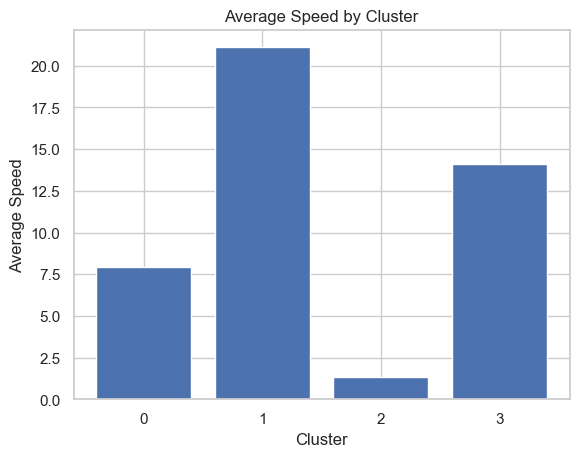

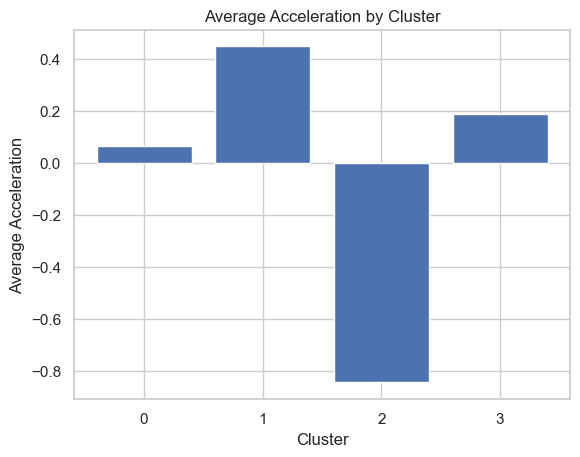

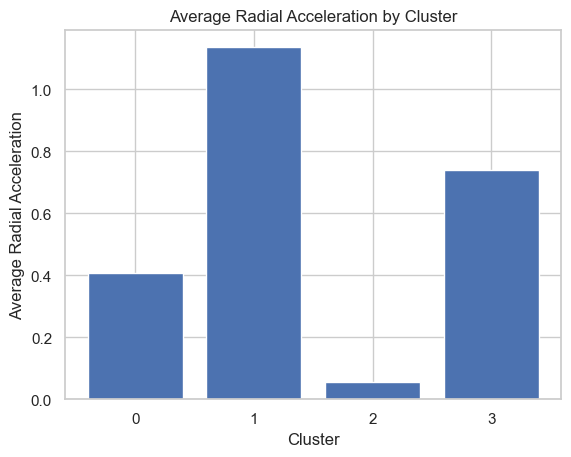

In [146]:
import matplotlib.pyplot as plt


# Calculate average values for each cluster
stat_vals = data_with_clusters.groupby('cluster').mean()

# stat_vals= cluster_data.groupby('TScluster').apply(lambda x: stats.mode(x)[0][0]).reset_index()

# stat_vals = cluster_data.groupby('TScluster').max().reset_index()



# Plot bar graph for Average Speed
plt.bar(stat_vals.index, stat_vals['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(stat_vals.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(stat_vals.index, stat_vals['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(stat_vals.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(stat_vals.index, stat_vals['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(stat_vals.index)
plt.show()

In [147]:
data_with_clusters

,speed,acceleration,radial_acceleration,cluster,deviceid,trip_id
0,14.03890,0.323975,0.000000,3,116,2.0
1,10.25920,-0.251980,1.278067,0,116,2.0
2,7.55940,-0.179987,0.722300,0,116,2.0
3,3.77970,-0.251980,0.048332,2,116,2.0
4,9.17927,0.359971,1.052222,0,116,2.0
...,...,...,...,...,...,...
144644,0.00000,-0.431965,0.000000,2,1377,1364.0
144645,3.77970,0.251980,0.040064,2,1377,1364.0
144646,9.17927,0.359971,0.955166,0,1377,1364.0
144647,12.95900,0.251982,1.233701,3,1377,1364.0


In [148]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,14.03890,0.323975,0.000000,0.000000,2,3
1,2.0,116,10.25920,-0.251980,1.278067,123.738485,2,3
2,2.0,116,7.55940,-0.179987,0.722300,163.044397,2,3
3,2.0,116,3.77970,-0.251980,0.048332,211.472339,2,3
4,2.0,116,9.17927,0.359971,1.052222,287.492821,2,3
...,...,...,...,...,...,...,...,...
144644,1364.0,1377,0.00000,-0.431965,0.000000,15556.443059,2,2
144645,1364.0,1377,3.77970,0.251980,0.040064,15568.142342,2,2
144646,1364.0,1377,9.17927,0.359971,0.955166,15631.694772,2,2
144647,1364.0,1377,12.95900,0.251982,1.233701,15739.603572,2,2


<Figure size 1000x600 with 0 Axes>

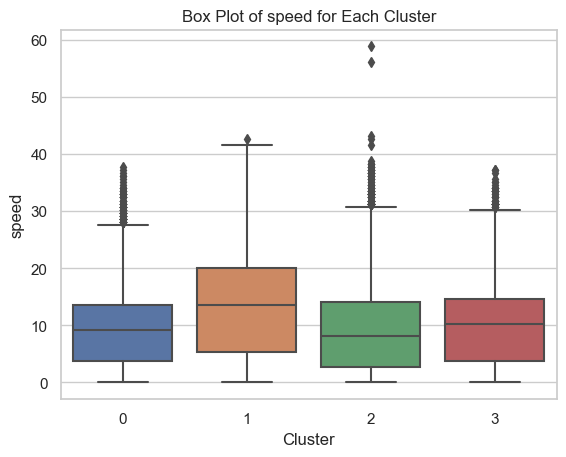

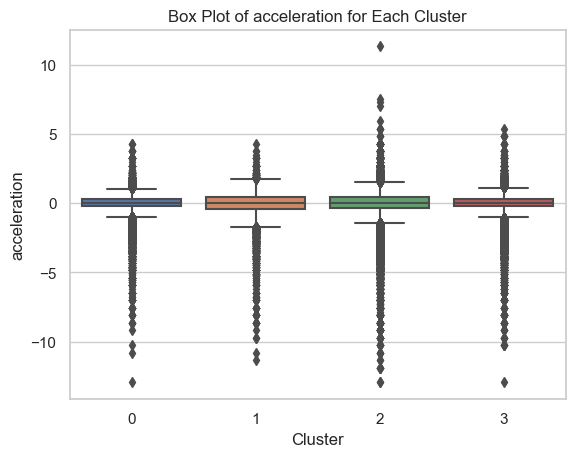

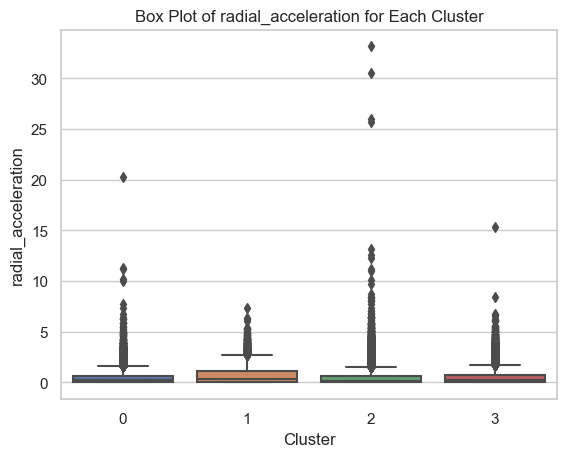

In [149]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming your DataFrame is named cluster_data
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))

# List of features to create box plots for
features = ['speed', 'acceleration', 'radial_acceleration']

for feature in features:
    plt.figure()
    sns.boxplot(x='NormCluster', y=feature, data=cluster_data)
    plt.title(f'Box Plot of {feature} for Each Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(feature)
    plt.show()


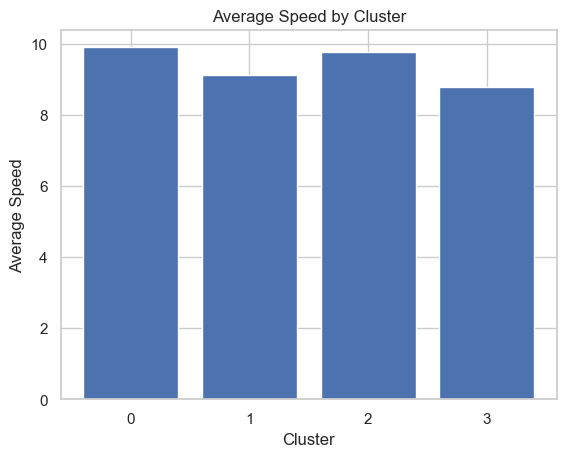

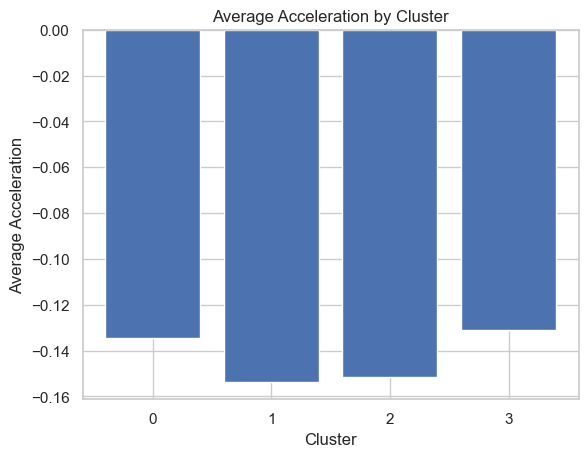

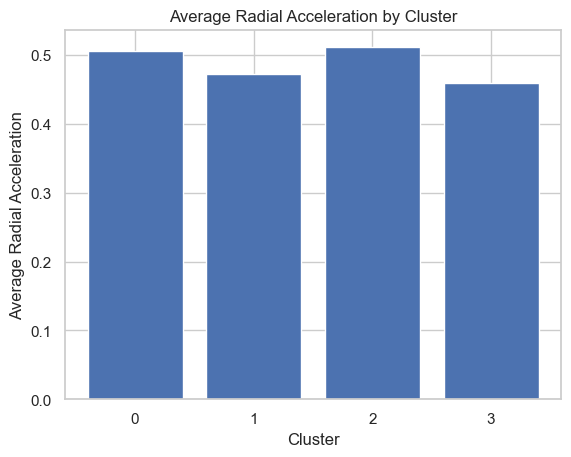

In [150]:
import matplotlib.pyplot as plt


# Calculate average values for each cluster
average_values = TSclusgrped

# Plot bar graph for Average Speed
plt.bar(average_values.index, average_values['speed'])
plt.xlabel('Cluster')
plt.ylabel('Average Speed')
plt.title('Average Speed by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Acceleration
plt.bar(average_values.index, average_values['acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Acceleration')
plt.title('Average Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

# Plot bar graph for Average Radial Acceleration
plt.bar(average_values.index, average_values['radial_acceleration'])
plt.xlabel('Cluster')
plt.ylabel('Average Radial Acceleration')
plt.title('Average Radial Acceleration by Cluster')
plt.xticks(average_values.index)
plt.show()

### assign cluster values to bus ids

In [164]:
cluster_data

,trip_id,deviceid,speed,acceleration,radial_acceleration,distance_from_start,TScluster,NormCluster
0,2.0,116,14.03890,0.323975,0.000000,0.000000,2,3
1,2.0,116,10.25920,-0.251980,1.278067,123.738485,2,3
2,2.0,116,7.55940,-0.179987,0.722300,163.044397,2,3
3,2.0,116,3.77970,-0.251980,0.048332,211.472339,2,3
4,2.0,116,9.17927,0.359971,1.052222,287.492821,2,3
...,...,...,...,...,...,...,...,...
144644,1364.0,1377,0.00000,-0.431965,0.000000,15556.443059,2,2
144645,1364.0,1377,3.77970,0.251980,0.040064,15568.142342,2,2
144646,1364.0,1377,9.17927,0.359971,0.955166,15631.694772,2,2
144647,1364.0,1377,12.95900,0.251982,1.233701,15739.603572,2,2


In [173]:
import pandas as pd

# Assuming your DataFrame is named df
# Group by 'deviceid' and 'TScluster', count occurrences
grouped = cluster_data.groupby(['deviceid', 'TScluster']).size().reset_index(name='count')

# Pivot the data to create a new DataFrame with clusters as columns
pivot_df = grouped.pivot(index='deviceid', columns='TScluster', values='count').fillna(0)

# Calculate the total counts for each bus ID
pivot_df['total'] = pivot_df.sum(axis=1)

# Calculate the percentage of times each cluster was assigned for each bus ID
for cluster in pivot_df.columns[:-1]:
    pivot_df[cluster] = pivot_df[cluster] / pivot_df['total'] * 100

# Reset the index and rename columns
pivot_df.reset_index(inplace=True)
pivot_df.columns.name = None

pivot_df = pivot_df[['deviceid', 0, 1, 2, 3]]

# rename cluster culumns
pivot_df.rename(columns={0: 'TSCluster 0', 1: 'TSCluster 1', 2: 'TSCluster 2', 3: 'TSCluster 3'}, inplace=True)

pivot_df


,deviceid,TSCluster 0,TSCluster 1,TSCluster 2,TSCluster 3
0,116,0.000000,29.490705,35.001650,35.507645
1,117,0.000000,50.269107,24.542519,25.188375
2,123,19.385096,15.015261,37.378099,28.221544
3,128,2.051828,45.846949,13.276085,38.825139
4,262,0.000000,37.264211,11.491082,51.244707
5,264,79.742470,11.014026,4.092895,5.150609
6,274,0.813201,36.807740,31.329020,31.050039
7,279,1.408624,51.590084,27.735745,19.265547
8,294,0.000000,50.193440,21.547519,28.259041
9,505,0.000000,38.602214,33.847371,27.550415


In [ ]:
# save csv

## Visulaise bus running on map

In [152]:
!pip install folium ipywidgets pandas



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [153]:
pip install ipywidgets


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [154]:
import folium
import pandas as pd
from ipywidgets import interact, IntSlider



# Convert timestamp column to datetime format
data['devicetime'] = pd.to_datetime(data['devicetime'])


In [155]:
data['devicetime'].min()

Timestamp('2021-10-01 06:40:04')

In [156]:
from geopy.geocoders import Nominatim

# Create a geolocator object
geolocator = Nominatim(user_agent="my_geocoder")

# Get the location coordinates (latitude, longitude) for Kandy
Nattarampota_location = geolocator.geocode("Nattarampota, Sri Lanka")
Nattarampota_latitude = Nattarampota_location.latitude
Nattarampota_longitude = Nattarampota_location.longitude

print("Latitude:", Nattarampota_latitude, "Longitude:", Nattarampota_longitude)
Nattarampota_location = [Nattarampota_latitude, Nattarampota_longitude]  # Kandy city location

Latitude: 7.2800104 Longitude: 80.6752889


In [157]:
from geopy.geocoders import Nominatim

# Create a geolocator object
geolocator = Nominatim(user_agent="my_geocoder")

# Get the location coordinates (latitude, longitude) for Kandy
kandy_location = geolocator.geocode("Kandy, Sri Lanka")
kandy_latitude = kandy_location.latitude
kandy_longitude = kandy_location.longitude

print("Latitude:", kandy_latitude, "Longitude:", kandy_longitude)
Kandy_location = [kandy_latitude, kandy_longitude]  # Kandy city location

Latitude: 7.2931208 Longitude: 80.6350358


In [158]:
from geopy.geocoders import Nominatim

# Create a geolocator object
geolocator = Nominatim(user_agent="my_geocoder")

# Get the location coordinates (latitude, longitude) for digana
digana_location = geolocator.geocode("Digana, Sri Lanka")
digana_latitude = digana_location.latitude
digana_longitude = digana_location.longitude

print("Latitude:", digana_latitude, "Longitude:", digana_longitude)
digana_location = [digana_latitude, digana_longitude]  # Kandy city location

Latitude: 7.2964937 Longitude: 80.7334168


In [159]:
data.head(20)

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,devicetime_seconds
0,574733099,116,2021-10-16 08:03:19,7.293068,80.636430,14.03890,2021-10-16,08:03:19,POINT (184841.00784031872 232320.15459256113),NaN,2.0,1,0.323975,0.000000,0.000000,1300995.0
1,574733100,116,2021-10-16 08:03:34,7.293043,80.637552,10.25920,2021-10-16,08:03:34,POINT (184964.84865244984 232317.35306792473),NaN,2.0,1,-0.251980,1.278067,123.738485,1301010.0
2,574733101,116,2021-10-16 08:03:49,7.292725,80.637707,7.55940,2021-10-16,08:03:49,POINT (184981.95255171193 232282.14959255166),NaN,2.0,1,-0.179987,0.722300,163.044397,1301025.0
3,574733102,116,2021-10-16 08:04:04,7.292292,80.637663,3.77970,2021-10-16,08:04:04,POINT (184977.15733984314 232234.22458233108),NaN,2.0,1,-0.251980,0.048332,211.472339,1301040.0
4,574736662,116,2021-10-16 08:04:19,7.291640,80.637455,9.17927,2021-10-16,08:04:19,POINT (184954.1363920236 232162.16484193364),101,2.0,1,0.359971,1.052222,287.492821,1301055.0
5,574736663,116,2021-10-16 08:04:34,7.291210,80.637713,8.63931,2021-10-16,08:04:34,POINT (184982.64260533327 232114.61697960715),101,2.0,1,-0.035997,0.639311,343.141212,1301070.0
6,574736664,116,2021-10-16 08:04:49,7.290943,80.638160,0.00000,2021-10-16,08:04:49,POINT (185031.9565310351 232085.11003064158),101,2.0,1,-0.575954,0.000000,400.646939,1301085.0
7,574736665,116,2021-10-16 08:05:04,7.290943,80.638157,0.00000,2021-10-16,08:05:04,POINT (185031.58111776915 232085.11014168937),101,2.0,1,0.000000,0.000000,401.021945,1301100.0
8,574736666,116,2021-10-16 08:05:19,7.290943,80.638157,0.00000,2021-10-16,08:05:19,POINT (185031.58111776915 232085.11014168937),101,2.0,1,0.000000,0.000000,401.021945,1301115.0
9,574736667,116,2021-10-16 08:05:34,7.290752,80.638305,6.47948,2021-10-16,08:05:34,POINT (185047.9605390529 232063.90664561786),101,2.0,1,0.431965,0.333808,427.897272,1301130.0


In [169]:
import folium
import pandas as pd
from shapely.geometry import Point
from ipywidgets import FloatSlider, interact, Label, Output, VBox, Button, HBox

# Assuming you have 'data' DataFrame containing bus data

# Dictionary to store last known location of each bus
bus_locations = {}

# Create Point geometries for Kandy and Digana
kandy_location = Point(kandy_latitude, kandy_longitude)
digana_location = Point(digana_latitude, digana_longitude)  # Define the coordinates for Digana

def create_map():
    return folium.Map(location=Nattarampota_location, zoom_start=14)

def update_map(timestamp):
    m = create_map()  # Create a new map instance each time
    interval = pd.Timedelta(seconds=15)
    timestamp_dt = pd.Timestamp.fromtimestamp(timestamp)  # Convert timestamp to pandas Timestamp
    interval_start = timestamp_dt - interval / 2
    interval_end = timestamp_dt + interval / 2

    bus_data_within_interval = data[(data['devicetime'] >= interval_start) & (data['devicetime'] <= interval_end)]
    bus_data_within_interval = bus_data_within_interval.sort_values(by='devicetime', ascending=False)
    unique_buses = data['deviceid'].unique()

    for deviceid in unique_buses:
        latest_data_for_bus = None  # Initialize the variable here

        bus_data_for_bus = bus_data_within_interval[bus_data_within_interval['deviceid'] == deviceid]
        if len(bus_data_for_bus) > 0:
            latest_data_for_bus = bus_data_for_bus.iloc[0]
            bus_location = [latest_data_for_bus['latitude'], latest_data_for_bus['longitude']]
            bus_locations[deviceid] = bus_location
        else:
            bus_location = bus_locations.get(deviceid)

        if bus_location is not None:
            bus_point = Point(bus_location[0], bus_location[1])

            # Adjust the color using a consistent formula
            color = "#{:06x}".format(deviceid + 100000)

            # get speed acceleration and radial acceleration into three variables
            if latest_data_for_bus is not None:
                speed = latest_data_for_bus['speed']
                acceleration = latest_data_for_bus['acceleration']
                radial_acceleration = latest_data_for_bus['radial_acceleration']
                print(speed, acceleration, radial_acceleration)
            else:
                speed = 0
                acceleration = 0
                radial_acceleration = 0

            folium.Marker(
                location=bus_location,
                popup=[deviceid, speed, acceleration, radial_acceleration],
                color=color  # Use the calculated color
            ).add_to(m)

    return m

min_timestamp = data['devicetime'].min()
max_timestamp = data['devicetime'].max()

# Calculate step size in seconds
step_size_seconds = 15
slider = FloatSlider(value=min_timestamp.timestamp(), min=min_timestamp.timestamp(), max=max_timestamp.timestamp(), step=step_size_seconds)

# Adjust the length of the slider using CSS style
slider.style.handle_length = '500px'  # Adjust the length as desired

time_label = Label(value=pd.Timestamp.fromtimestamp(slider.value).strftime('%Y-%m-%d %H:%M:%S'))

def update_time_label(change):
    time_label.value = pd.Timestamp.fromtimestamp(change['new']).strftime('%Y-%m-%d %H:%M:%S')

slider.observe(update_time_label, 'value')

stop = False  # Declare stop as a global variable

# Button to stop continuous play
def stop_continuous(_):
    global stop
    stop = True
    
# Button to move slider left
def move_left(_):
    slider.value -= step_size_seconds

# Button to move slider right
def move_right(_):
    slider.value += step_size_seconds

# Button to move slider left continuously
def move_left_continuous(_):
    while slider.value > slider.min and not stop:
        slider.value -= step_size_seconds

# Button to move slider right continuously
def move_right_continuous(_):
    while slider.value < slider.max and not stop:
        slider.value += step_size_seconds





left_button = Button(description='<<', icon='angle-left')
right_button = Button(description='>>', icon='angle-right')
left_continuous_button = Button(description='Continuous <<', icon='step-backward')
right_continuous_button = Button(description='Continuous >>', icon='step-forward')
stop_button = Button(description='Stop', icon='stop')

left_button.on_click(move_left)
right_button.on_click(move_right)
left_continuous_button.on_click(move_left_continuous)
right_continuous_button.on_click(move_right_continuous)
stop_button.on_click(stop_continuous)

buttons_row = HBox([left_button, left_continuous_button, right_button, right_continuous_button, stop_button])
controls_box = VBox([buttons_row, slider, time_label])

out_map = Output()
out_map.layout.height = '1000px'  # Adjust the height as desired

def update_map_output(change):
    with out_map:
        out_map.clear_output(wait=True)
        display(update_map(slider.value))

slider.observe(update_map_output, 'value')

app_layout = VBox([controls_box, out_map])

display(app_layout)


In [161]:
# Anomaly trips detected and removed: [166.0, 193.0, 195.0, 207.0, 235.0, 1081.0, 1105.0, 141.0, 147.0, 153.0, 155.0, 157.0, 160.0, 171.0, 177.0, 190.0, 194.0, 206.0, 210.0, 226.0, 879.0]

In [162]:
import folium
from shapely.geometry import Point
import pandas as pd

# Function to create the map
def create_map():
    return folium.Map(location=[kandy_latitude, kandy_longitude], zoom_start=14)

# Function to plot a specific trip on the map
def plot_trip_on_map(trip_id):
    m = create_map()  # Create a new map instance each time
    
    trip_data = data[data['trip_id'] == trip_id]
    trip_data = trip_data.sort_values(by='devicetime')
    
    for index, row in trip_data.iterrows():
        bus_location = [row['latitude'], row['longitude']]
        bus_point = Point(bus_location[0], bus_location[1])
        color = "#{:06x}".format(int(trip_id) + 100000)  # Adjust the color using a consistent formula
        
        # Add a marker for each point in the trip data
        folium.Marker(
            location=bus_location,
            color=color,
            popup=f"Trip ID: {trip_id}<br>Speed: {row['speed']}<br>Acceleration: {row['acceleration']}<br>Radial Acceleration: {row['radial_acceleration']}"
        ).add_to(m)
    
    return m

# Replace 'your_trip_id_here' with the actual trip ID you want to visualize
trip_id_to_visualize = 1364

map_for_trip = plot_trip_on_map(trip_id_to_visualize)
display(map_for_trip)


In [163]:
data[data['trip_id'] == 1364]

,id,deviceid,devicetime,latitude,longitude,speed,date,time,geometry,bus_stop,trip_id,direction,acceleration,radial_acceleration,distance_from_start,devicetime_seconds
144426,585187550,1377,2021-10-27 16:31:12,7.293082,80.636260,9.17927,2021-10-27,16:31:12,POINT (184822.22666393613 232321.6309718457),NaN,1364.0,1,0.215983,0.000000,0.000000,2281868.0
144427,585187552,1377,2021-10-27 16:31:27,7.293023,80.637010,9.71923,2021-10-27,16:31:27,POINT (184905.03610227202 232315.15923282798),NaN,1364.0,1,0.035997,0.083882,82.975132,2281883.0
144428,585187553,1377,2021-10-27 16:31:42,7.293017,80.637617,5.39957,2021-10-27,16:31:42,POINT (184972.02476036065 232314.39838397998),NaN,1364.0,1,-0.287977,0.544436,149.895468,2281898.0
144429,585187554,1377,2021-10-27 16:31:57,7.292937,80.637695,0.00000,2021-10-27,16:31:57,POINT (184980.66764083412 232305.54922084516),NaN,1364.0,1,-0.359971,0.000000,162.293625,2281913.0
144430,585187555,1377,2021-10-27 16:32:12,7.292460,80.637723,7.01944,2021-10-27,16:32:12,POINT (184983.78778762638 232252.84469834273),NaN,1364.0,1,0.467963,0.328044,215.381619,2281928.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144644,585256700,1377,2021-10-27 17:24:17,7.297480,80.732092,0.00000,2021-10-27,17:24:17,POINT (195403.52545714873 232805.9635712482),NaN,1364.0,1,-0.431965,0.000000,15556.443059,2285053.0
144645,585256702,1377,2021-10-27 17:24:32,7.297510,80.732193,3.77970,2021-10-27,17:24:32,POINT (195414.75483010974 232809.26899391826),NaN,1364.0,1,0.251980,0.040064,15568.142342,2285068.0
144646,585256704,1377,2021-10-27 17:24:47,7.297613,80.732760,9.17927,2021-10-27,17:24:47,POINT (195477.32731263872 232820.69775065468),NaN,1364.0,1,0.359971,0.955166,15631.694772,2285083.0
144647,585256706,1377,2021-10-27 17:25:02,7.298523,80.733100,12.95900,2021-10-27,17:25:02,POINT (195514.8655653549 232921.3243238285),NaN,1364.0,1,0.251982,1.233701,15739.603572,2285098.0
